**Explainbale Artificial Intelligence in Face Recognition using LIME and Saliency maps**

First install required libraries

In [ ]:
!pip install numpy tensorflow keras matplotlib scikit-image scikit-learn lime tf-keras-vis

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 4.3 MB/s eta 0:00:00
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=e2f1aa70549c9d5420c1c8721e0c106b8b3c36f3411f8df5d3ff4ed011644051
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


Import the ibraries to the project

For the first part import tenserflow for model initialization

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from lime import lime_image
from skimage.segmentation import mark_boundaries
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from random import choice
from random import sample
from tf_keras_vis.utils.scores import CategoricalScore
from tf_keras_vis.saliency import Saliency
from tensorflow.keras import backend as K
from tf_keras_vis.utils import normalize
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix

Connect to the google Drive for reading dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Load the dataset using numpy

In [ ]:
# Load the face dataset

data = np.load('/content/drive/MyDrive/Colab Notebooks/inception_final/lfw_train_test_compressed_aligned.npz')
trainX, trainy, testX, testy = data['arr_0'], data['arr_1'], data['arr_2'], data['arr_3']
print('Loaded: ', trainX.shape, trainy.shape, testX.shape, testy.shape)

# Preporcess the loaded data

label_encoder = LabelEncoder()
trainy_encoded = label_encoder.fit_transform(trainy)
testy_encoded = label_encoder.transform(testy)
trainy_one_hot = to_categorical(trainy_encoded)
testy_one_hot = to_categorical(testy_encoded)
trainX = trainX.astype('float32') / 255
testX = testX.astype('float32') / 255

Loaded:  (1028, 160, 160, 3) (1028,) (112, 160, 160, 3) (112,)


**MODEL INITIALIZATION**

Load pre-trained Inception Model

In [ ]:
# Load InceptionV3 model pre-trained on ImageNet without the top layer
base_model = InceptionV3(include_top=False, weights='imagenet', input_shape=(160, 160, 3))

87910968/87910968 [==============================] - 0s 0us/step


Now add a custom top layer because - The pre-trained model was originally designed to classify images into 1000 categories from the ImageNet dataset, which is not our target classes.

In [ ]:
# Add custom layers on top of InceptionV3
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(trainy_one_hot.shape[1], activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

Initialize Early stopping for prevent overfitting

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

Now start training the model. This may take some time depending on the machine.

In [ ]:
# Train the model
history = model.fit(trainX, trainy_one_hot, epochs=50, batch_size=32, validation_split=0.1, callbacks=[early_stopping])

Epoch 1/50
29/29 [==============================] - 4s 147ms/step - loss: 0.0125 - accuracy: 0.9924 - val_loss: 0.2763 - val_accuracy: 0.9126
Epoch 2/50
29/29 [==============================] - 4s 133ms/step - loss: 0.0098 - accuracy: 0.9946 - val_loss: 0.1199 - val_accuracy: 0.9709
Epoch 3/50
29/29 [==============================] - 4s 126ms/step - loss: 0.0070 - accuracy: 0.9957 - val_loss: 0.1573 - val_accuracy: 0.9320
Epoch 4/50
29/29 [==============================] - 4s 128ms/step - loss: 0.0060 - accuracy: 0.9957 - val_loss: 0.1674 - val_accuracy: 0.9320
Epoch 5/50
29/29 [==============================] - 4s 132ms/step - loss: 0.0070 - accuracy: 0.9978 - val_loss: 0.2636 - val_accuracy: 0.9029
Epoch 6/50
29/29 [==============================] - 4s 126ms/step - loss: 0.0132 - accuracy: 0.9924 - val_loss: 0.4569 - val_accuracy: 0.8641
Epoch 7/50
29/29 [==============================] - 4s 126ms/step - loss: 0.0074 - accuracy: 0.9978 - val_loss: 0.2986 - val_accuracy: 0.9126
Epoch 

In [ ]:
# Evaluate the model on the test set
loss, accuracy = model.evaluate(testX, testy_one_hot)
print(f'Test Loss: {loss}')
print(f'Test Accuracy: {accuracy}')
print(f"Test Accuracy: {accuracy*100:.2f}%")

4/4 [==============================] - 0s 52ms/step - loss: 0.1359 - accuracy: 0.9643
Test Loss: 0.1359299123287201
Test Accuracy: 0.9642857313156128
Test Accuracy: 96.43%


In [ ]:
# Make predictions
y_pred_one_hot = model.predict(testX)
y_pred = np.argmax(y_pred_one_hot, axis=1)
testy_labels = np.argmax(testy_one_hot, axis=1)

4/4 [==============================] - 0s 56ms/step


Calculate Metrics for our model to get performance

In [ ]:
# Calculate metrics
accuracy = accuracy_score(testy_labels, y_pred)
precision = precision_score(testy_labels, y_pred, average='weighted')
recall = recall_score(testy_labels, y_pred, average='weighted')
f1 = f1_score(testy_labels, y_pred, average='weighted')
error_rate = 1 - accuracy

# Create DataFrames for the metrics
metrics_data = {
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1-Score'],
    'Score': [accuracy, precision, recall, f1]
}

error_rate_data = {
    'Metric': ['Error Rate'],
    'Score': [error_rate]
}

metrics_df = pd.DataFrame(metrics_data)
error_rate_df = pd.DataFrame(error_rate_data)

# Display the tables
print("\nMetrics:")
print(metrics_df)

print("\nError Rate:")
print(error_rate_df)


Metrics:
      Metric     Score
0   Accuracy  0.964286
1  Precision  0.966328
2     Recall  0.964286
3   F1-Score  0.963877

Error Rate:
       Metric     Score
0  Error Rate  0.035714


Now take a random image from the test case and try to predict. This will give you model prediction along with probability made by the model

selection -  72
1/1 [==============================] - 1s 1s/step
Predicted: George_W_Bush (99.816)
Expected: George_W_Bush


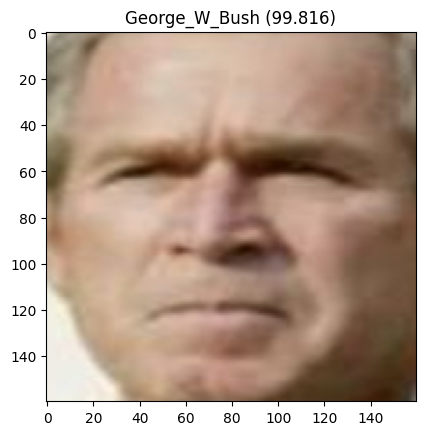

In [ ]:
# Select a random face from the test set

selection = choice([i for i in range(testX.shape[0])])
random_face = testX[selection]
random_face_class = testy[selection]

# Preprocessing for the model prediction
# Model expects batch dimension
random_face_preprocessed = np.expand_dims(random_face, axis=0)

# Prediction for the face
yhat_class = model.predict(random_face_preprocessed)
class_index = np.argmax(yhat_class[0])
class_probability = yhat_class[0, class_index] * 100
predict_names = label_encoder.inverse_transform([class_index])

# Output prediction results
print('Predicted: %s (%.3f)' % (predict_names[0], class_probability))
print('Expected: %s' % random_face_class)

# Plot face
plt.imshow(random_face)
title = '%s (%.3f)' % (predict_names[0], class_probability)
plt.title(title)
plt.show()

In [ ]:
def model_image_predict(temp_image):
    prob_class = model.predict(np.expand_dims(temp_image, axis=0))
    class_ind = np.argmax(prob_class[0])
    probability = prob_class[0, class_ind] * 100
    predict_names = label_encoder.inverse_transform([class_ind])
    f_name = predict_names[0].split('_')[0]
    return probability, f_name

IMAGE EXPLANATION

Initialize a class that explain an image using LIME's LimeImageExplainer

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 43ms/step


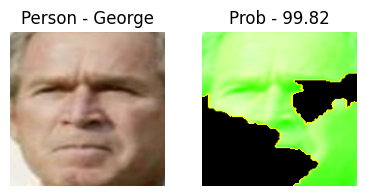

In [ ]:
# import random

def explain_prediction_org(image, model, top_labels=3):

    explainer = lime_image.LimeImageExplainer()
    ra_image = image

    # Ensure the image is in the correct format for LIME
    # So, Convert back to original scale as LIME expects uint8 images
    image = np.uint8(image * 255)

    # Define a prediction function with suppressed output
    def model_predict(img_batch):
        return model.predict(img_batch, verbose=0)

    explanation = explainer.explain_instance(image,
                                             model_predict,
                                             top_labels=top_labels,
                                             hide_color=0,
                                             num_samples=1000,
                                             batch_size=10)

    probabilities, first_name = model_image_predict(ra_image)

    fig, ax = plt.subplots(1, 2, figsize=(4, 2))  # Set up a figure with two subplots

    # Display the original image
    ax[0].imshow(image)
    ax[0].set_title(f'Person - {first_name}')
    ax[0].axis('off')  # Hide axes for clarity

    # Get the image with LIME explanations
    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0],
                                                positive_only=False,
                                                num_features=10,
                                                hide_rest=True,
                                                min_weight=0.0)

    # Display the image with explanations
    ax[1].imshow(mark_boundaries(temp / 255.0, mask))
    ax[1].set_title(f'Prob - {probabilities:.2f}')
    ax[1].axis('off')  # Hide axes for clarity

    return plt



plt = explain_prediction_org(random_face, model)
plt.tight_layout()
plt.show()

Set up to find labels and it's indices

In [ ]:
print('num_classes = ', testy_one_hot.shape)
print('Loaded: ', trainX.shape, trainy.shape, testX.shape, testy.shape)

# Finding unique classes in the encoded test labels
unique_classes = np.unique(testy_encoded)

# Setting up a dictionary to store indices of each class
class_indices = {cls: np.where(testy_encoded == cls)[0] for cls in unique_classes}


num_classes =  (112, 5)
Loaded:  (1028, 160, 160, 3) (1028,) (112, 160, 160, 3) (112,)


Take random 5 images from each class and explain it using LIME

CLASS -  Colin_Powell


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 38ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 47ms/step


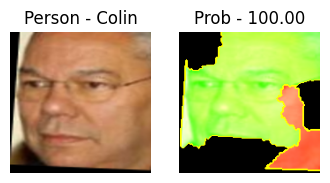

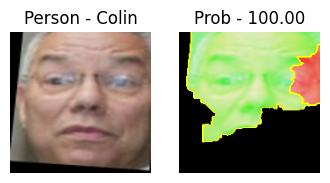

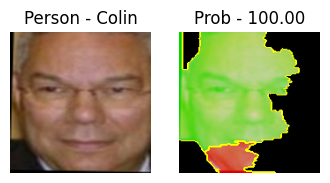

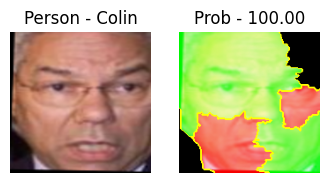

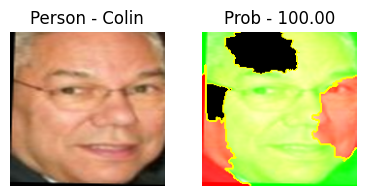

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

CLASS -  Donald_Rumsfeld


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 42ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 41ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 42ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


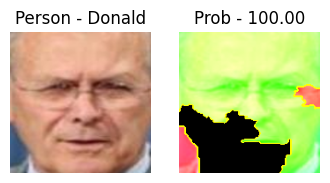

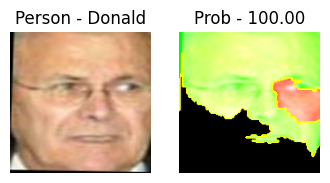

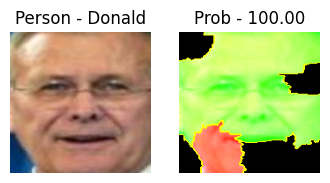

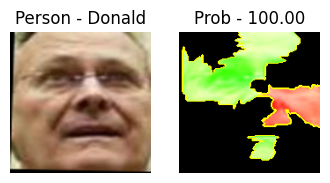

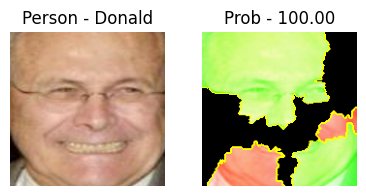

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

CLASS -  George_W_Bush


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 36ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 52ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 40ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 34ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 38ms/step


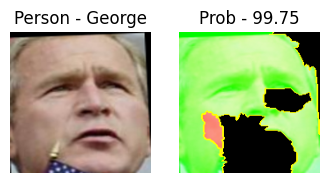

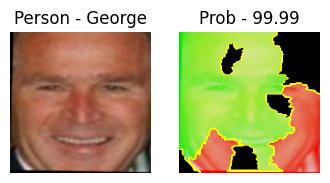

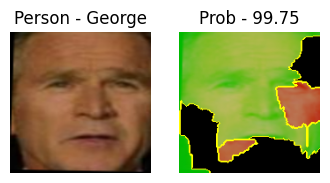

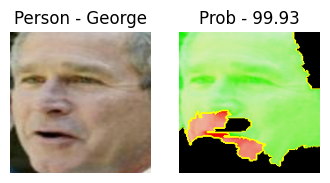

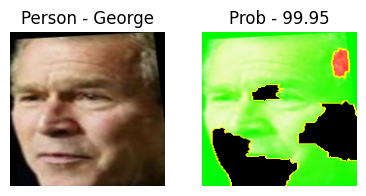

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

CLASS -  Gerhard_Schroeder


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 36ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 36ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 37ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 37ms/step


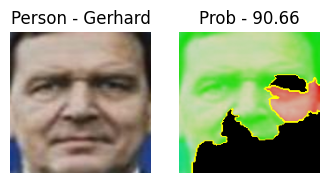

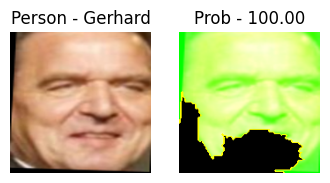

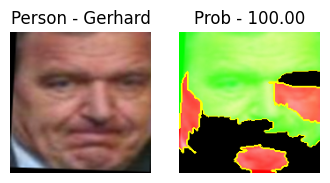

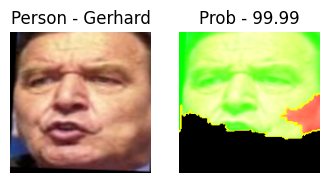

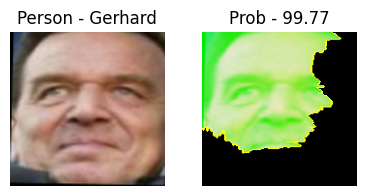

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

CLASS -  Tony_Blair


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 34ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 45ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 36ms/step


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 36ms/step


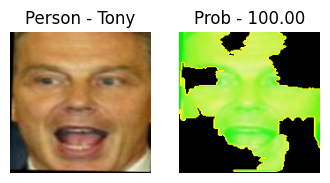

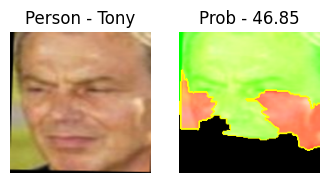

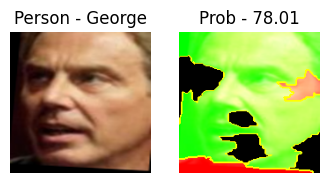

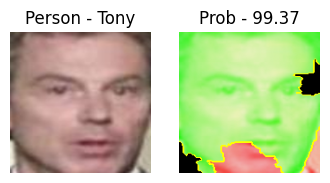

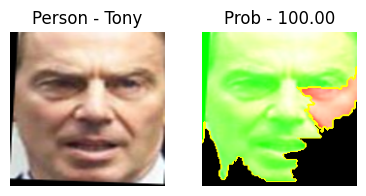

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:

for row, class_id in enumerate(unique_classes):
    print('CLASS - ', label_encoder.inverse_transform([class_id])[0])
    available_indices = class_indices[class_id]
    selected_indices = sample(list(available_indices), min(len(available_indices), 5))
    img_list = []
    for col, idx in enumerate(selected_indices):
      plt = explain_prediction_org(testX[idx], model)
      img_list.append(plt)
    for plt in img_list:
      plt.tight_layout()
      plt.show()


Initialize the Saliency Map and generate the saliency map for random face

1/1 [==============================] - 0s 26ms/step


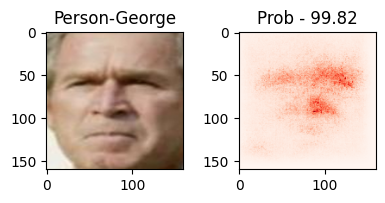

In [ ]:

score = CategoricalScore([0])

#Create Saliency object
saliency = Saliency(model, clone=False)


subplot_args = {
   'nrows': 1,
   'ncols': 2,
   'figsize': (4, 2)
}

# Generate saliency map
saliency_map = saliency(score, random_face, smooth_samples=20, smooth_noise=0.2)
saliency_map = normalize(saliency_map)

probabilities, first_name = model_image_predict(random_face)

f, ax = plt.subplots(**subplot_args)

# Original image on the left
ax[0].imshow(random_face.squeeze())  # Use squeeze() in case random_face has a batch dimension
ax[0].set_title(f'Person-{first_name}')
ax[0].axis('on')  # 'on' to turn on axis

# Saliency map on the right
ax[1].imshow(saliency_map[0], cmap='Reds')
ax[1].set_title(f'Prob - {probabilities:.2f}')
ax[1].axis('on')  # 'on' to turn on axis

plt.tight_layout()
plt.show()

CLASS -  Colin_Powell
1/1 [==============================] - 0s 25ms/step


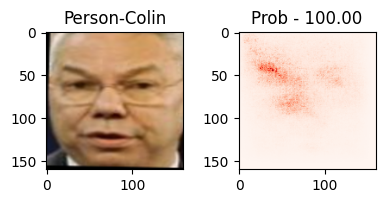

1/1 [==============================] - 0s 27ms/step


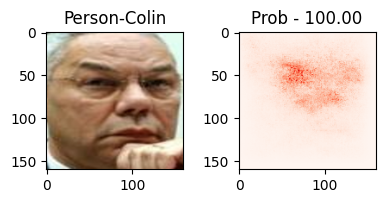

1/1 [==============================] - 0s 37ms/step


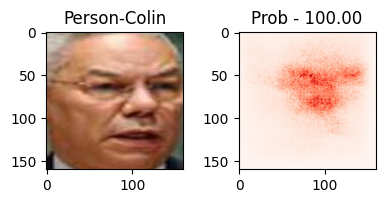

1/1 [==============================] - 0s 26ms/step


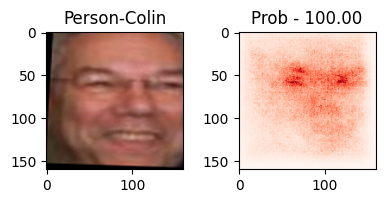

1/1 [==============================] - 0s 27ms/step


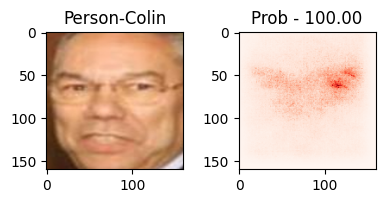

CLASS -  Donald_Rumsfeld
1/1 [==============================] - 0s 26ms/step


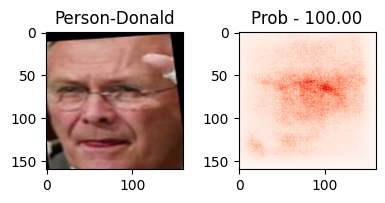

1/1 [==============================] - 0s 28ms/step


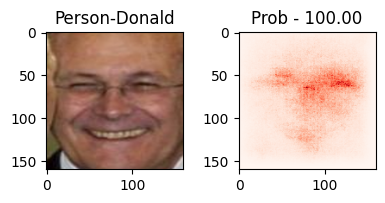

1/1 [==============================] - 0s 26ms/step


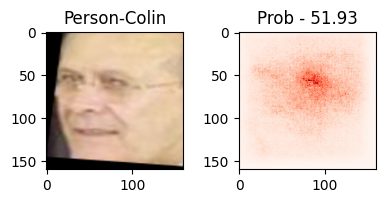

1/1 [==============================] - 0s 28ms/step


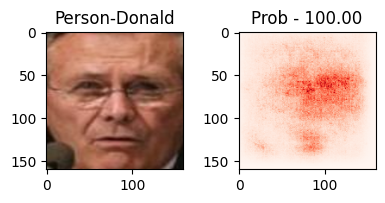

1/1 [==============================] - 0s 39ms/step


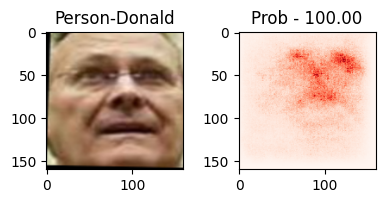

CLASS -  George_W_Bush
1/1 [==============================] - 0s 29ms/step


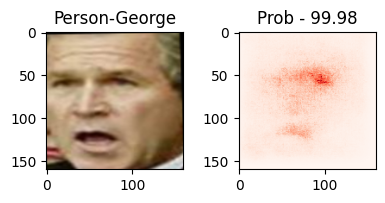

1/1 [==============================] - 0s 29ms/step


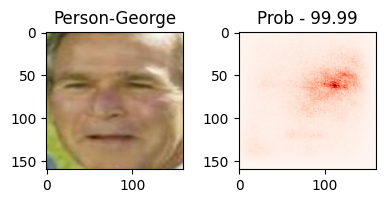

1/1 [==============================] - 0s 27ms/step


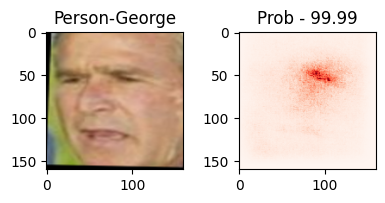

1/1 [==============================] - 0s 27ms/step


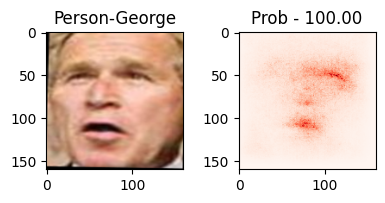

1/1 [==============================] - 0s 28ms/step


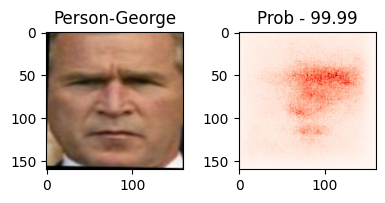

CLASS -  Gerhard_Schroeder
1/1 [==============================] - 0s 28ms/step


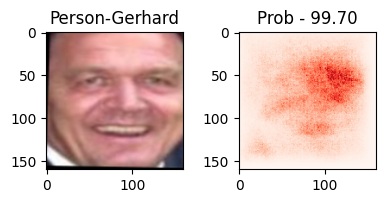

1/1 [==============================] - 0s 41ms/step


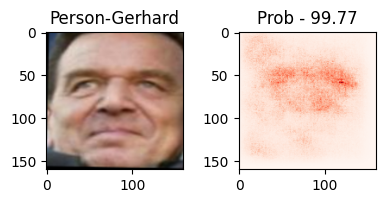

1/1 [==============================] - 0s 25ms/step


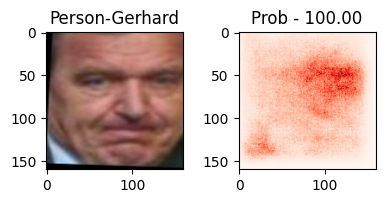

1/1 [==============================] - 0s 44ms/step


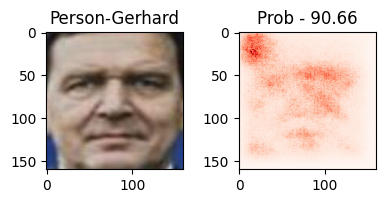

1/1 [==============================] - 0s 26ms/step


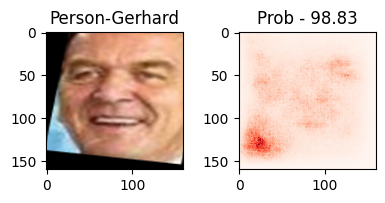

CLASS -  Tony_Blair
1/1 [==============================] - 0s 27ms/step


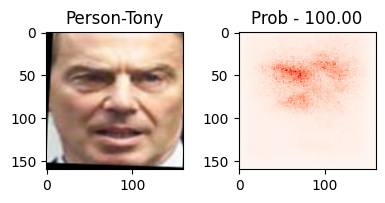

1/1 [==============================] - 0s 27ms/step


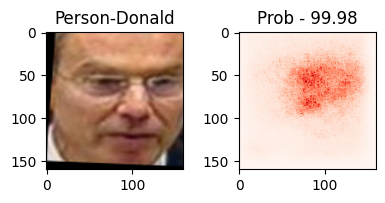

1/1 [==============================] - 0s 30ms/step


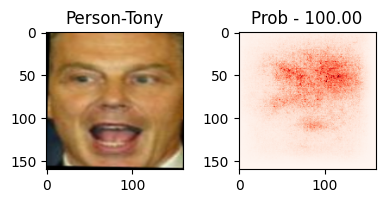

1/1 [==============================] - 0s 46ms/step


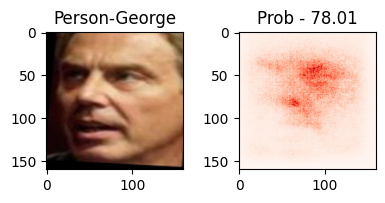

1/1 [==============================] - 0s 28ms/step


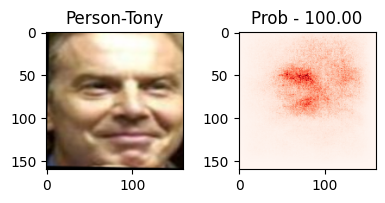

In [ ]:

subplot_args = {
   'nrows': 1,
   'ncols': 2,
   'figsize': (4, 2)
}

saliency = Saliency(model, clone=False)

for row, class_id in enumerate(unique_classes):
    print('CLASS - ', label_encoder.inverse_transform([class_id])[0])
    available_indices = class_indices[class_id]
    selected_indices = sample(list(available_indices), min(len(available_indices), 5))
    for col, idx in enumerate(selected_indices):

      score = CategoricalScore([class_id])
      # Generate saliency map
      saliency_map = saliency(score, testX[idx], smooth_samples=20, smooth_noise=0.2)
      saliency_map = normalize(saliency_map)

      probabilities, first_name = model_image_predict(testX[idx])

      f, ax = plt.subplots(**subplot_args)

      # Original image on the left
      ax[0].imshow(testX[idx].squeeze())
      ax[0].set_title(f'Person-{first_name}')
      ax[0].axis('on')

      # Saliency map on the right
      ax[1].imshow(saliency_map[0], cmap='Reds')
      ax[1].set_title(f'Prob - {probabilities:.2f}')
      ax[1].axis('on')

      plt.tight_layout()
      plt.show()

**IMAGE OCCLUSION**

Next three cells are function initialization of the occluding - both eye including glabella (area between eyebrows), Right eye and Left eye.

In [ ]:
def occlude_image_and_predict_full(model, image, occlusion_size=(30, 30), occlusion_pixel=(0, 0, 0)):

    # Convert occlusion pixel to a numpy array and normalize
    occlusion_pixel = np.array(occlusion_pixel) / 255.0

    # Defining eye positions
    right_eye_pos = (40, 60)
    left_eye_pos = (120, 60)

    # Calculate the rectangle size to cover both eyes
    width = left_eye_pos[0] - right_eye_pos[0] + 30
    height = 30

    # Calculate the top-left corner of the rectangle
    top_left_x = right_eye_pos[0] - 15
    top_left_y = right_eye_pos[1] - height // 2

    # Apply occlusion covering both eyes
    image[top_left_y:top_left_y + height, top_left_x:top_left_x + width, :] = occlusion_pixel

    # Predict
    image_preprocessed = np.expand_dims(image, axis=0)
    prediction = model.predict(image_preprocessed)

    # Prediction for the face
    print('prediction - ', prediction)
    class_index = np.argmax(prediction[0])
    class_probability = yhat_class[0, class_index] * 100
    # print('class_index - ', class_index)
    predict_names = label_encoder.inverse_transform([class_index])

    return predict_names, image

In [ ]:
def occlude_image_and_predict_right(model, image, occlusion_size=(50, 50), occlusion_pixel=(0, 0, 0)):

    # Convert occlusion pixel to a numpy array and normalize
    occlusion_pixel = np.array(occlusion_pixel) / 255.0

    # Right eye position (40, 100), left eye position (120, 100) - average pos
    right_eye_pos = (40 - occlusion_size[0] // 2, 60 - occlusion_size[1] // 2)

    # Apply occlusion on the right eye
    image[right_eye_pos[1]:right_eye_pos[1] + occlusion_size[1], right_eye_pos[0]:right_eye_pos[0] + occlusion_size[0], :] = occlusion_pixel / 255.0

    # Predict
    image_preprocessed = np.expand_dims(image, axis=0)
    prediction = model.predict(image_preprocessed)

    # Prediction for the face
    print('prediction - ', prediction)
    class_index = np.argmax(prediction[0])
    class_probability = yhat_class[0, class_index] * 100
    # print('class_index - ', class_index)
    predict_names = label_encoder.inverse_transform([class_index])

    return predict_names, image

In [ ]:
def occlude_image_and_predict_left(model, image, occlusion_size=(50, 50), occlusion_pixel=(0, 0, 0)):

    # Convert occlusion pixel to a numpy array and normalize
    occlusion_pixel = np.array(occlusion_pixel) / 255.0

    # Right eye position (40, 100), left eye position (120, 100)
    left_eye_pos = (120 - occlusion_size[0] // 2, 60 - occlusion_size[1] // 2)

    # Apply occlusion on the left eye
    image[left_eye_pos[1]:left_eye_pos[1] + occlusion_size[1], left_eye_pos[0]:left_eye_pos[0] + occlusion_size[0], :] = occlusion_pixel / 255.0

    # Predict
    image_preprocessed = np.expand_dims(image, axis=0)
    prediction = model.predict(image_preprocessed)

    # Prediction for the face
    print('prediction - ', prediction)
    class_index = np.argmax(prediction[0])
    class_probability = yhat_class[0, class_index] * 100
    # print('class_index - ', class_index)
    predict_names = label_encoder.inverse_transform([class_index])

    return predict_names, image

Now the occlusion of the all types starts here. first with both eye and glabella. Take random 5 image from different class and predict the altered image

CLASS -  Colin_Powell
1/1 [==============================] - 0s 26ms/step
prediction -  [[0.21820916 0.6430061  0.11113315 0.00932656 0.018325  ]]


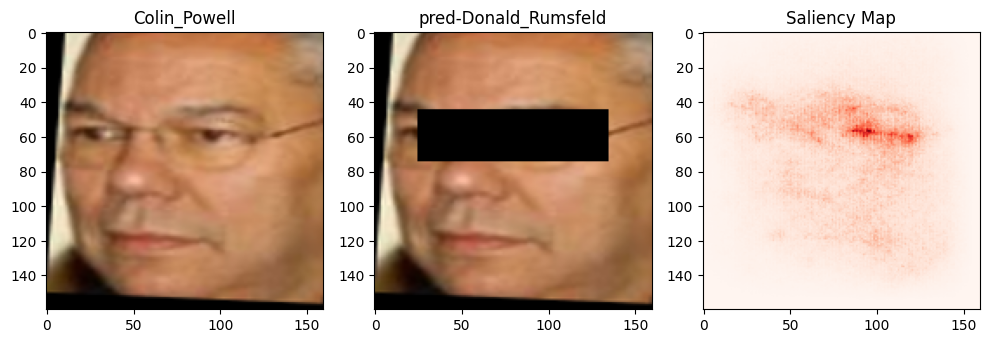

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.72161114 0.24710508 0.02215377 0.00229366 0.00683641]]


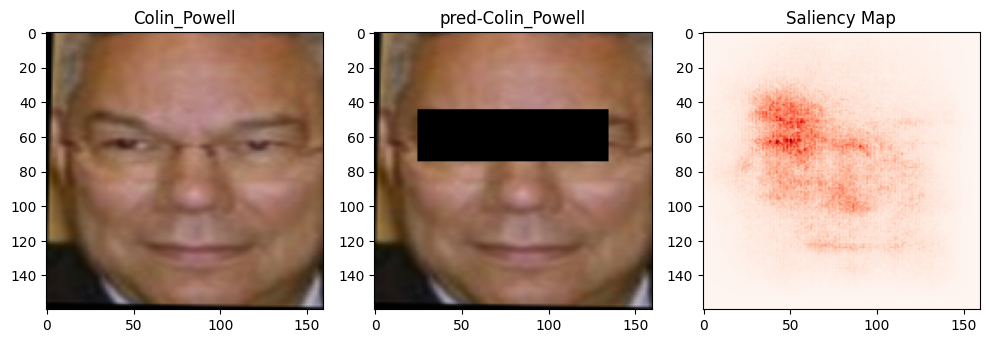

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.85213685 0.13209417 0.01089969 0.00119096 0.0036783 ]]


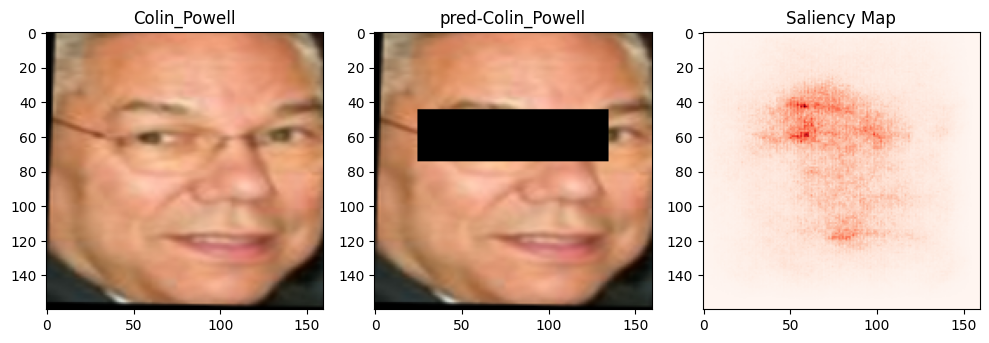

1/1 [==============================] - 0s 25ms/step
prediction -  [[0.7557803  0.21115528 0.02245091 0.00276886 0.00784464]]


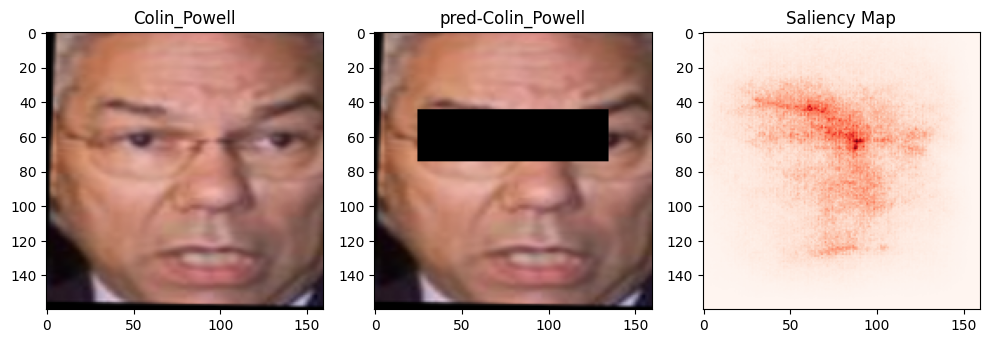

1/1 [==============================] - 0s 45ms/step
prediction -  [[0.09345374 0.6566116  0.18608266 0.01464615 0.04920585]]


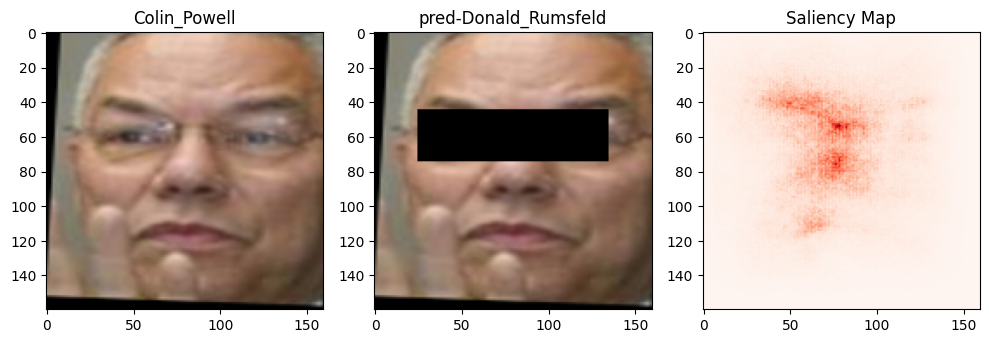

CLASS -  Donald_Rumsfeld
1/1 [==============================] - 0s 24ms/step
prediction -  [[0.03932715 0.07684231 0.07153636 0.05690908 0.75538516]]


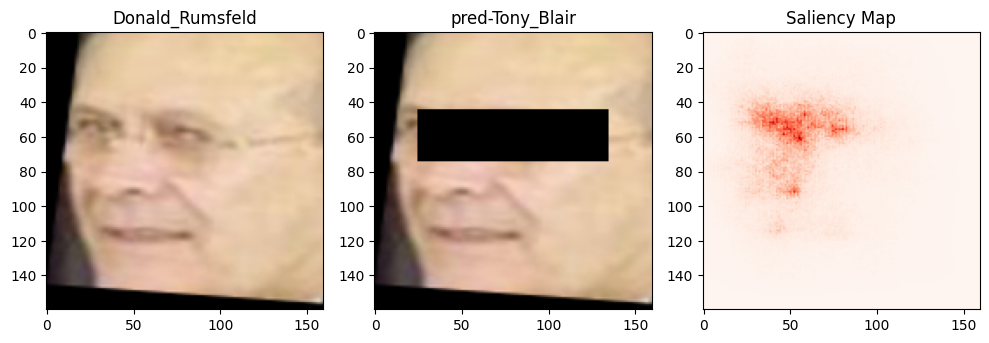

1/1 [==============================] - 0s 47ms/step
prediction -  [[0.0612359  0.88376945 0.04386307 0.00315128 0.0079803 ]]


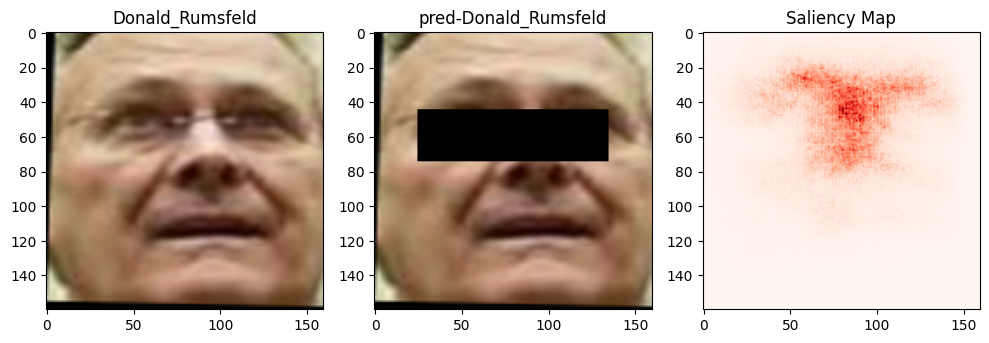

1/1 [==============================] - 0s 25ms/step
prediction -  [[0.14944601 0.62714225 0.13992251 0.01738586 0.06610338]]


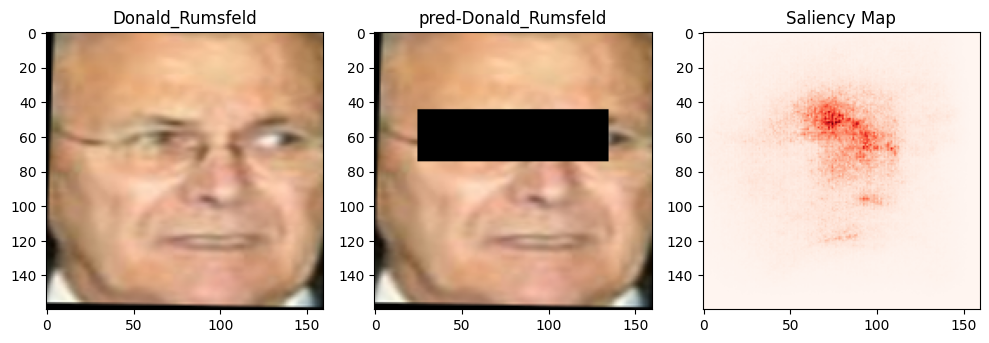

1/1 [==============================] - 0s 43ms/step
prediction -  [[0.03331392 0.23262492 0.27683875 0.05552389 0.40169853]]


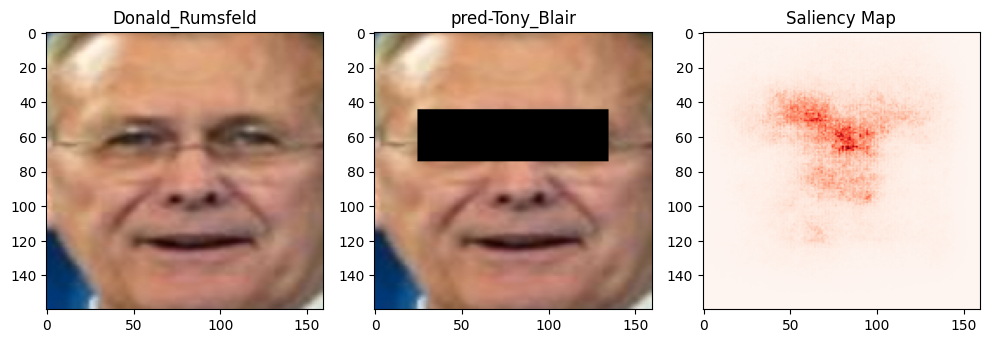

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.01164998 0.07520045 0.20207526 0.04876593 0.6623084 ]]


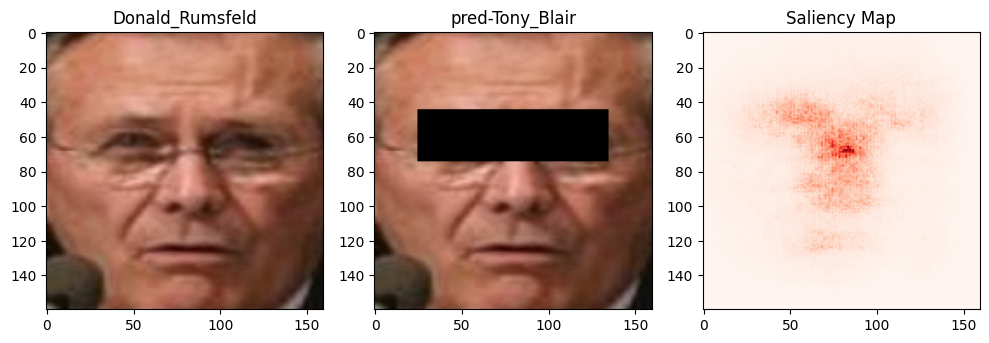

CLASS -  George_W_Bush
1/1 [==============================] - 0s 28ms/step
prediction -  [[0.0368324  0.20387684 0.7445195  0.00313714 0.01163405]]


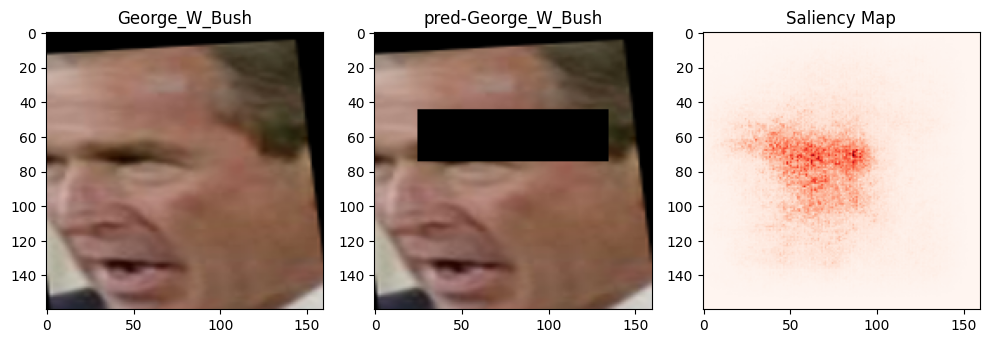

1/1 [==============================] - 0s 26ms/step
prediction -  [[0.03320239 0.6362573  0.31922975 0.00239617 0.00891439]]


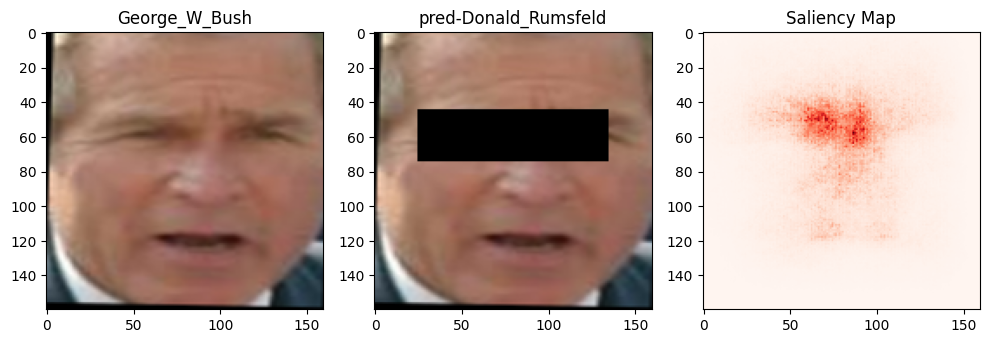

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.03732638 0.32638365 0.22974518 0.05553866 0.35100618]]


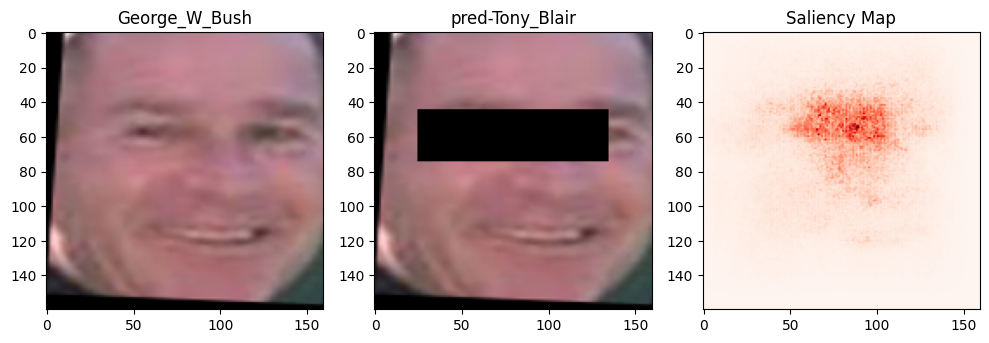

1/1 [==============================] - 0s 28ms/step
prediction -  [[0.00768038 0.05059563 0.57185477 0.02510617 0.344763  ]]


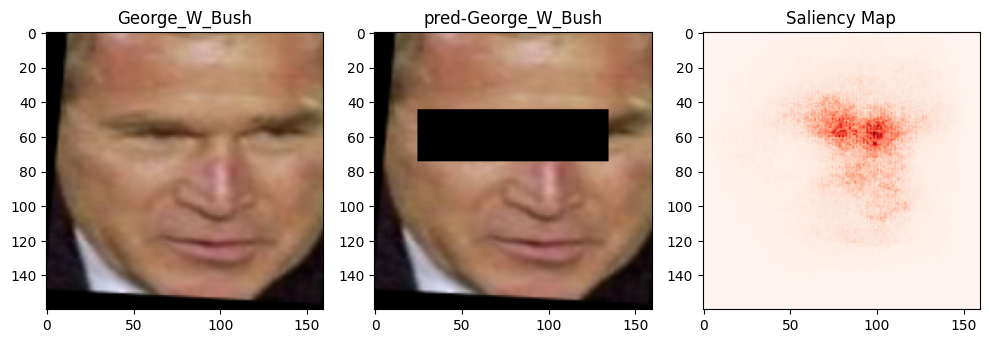

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.09569915 0.6885391  0.15561667 0.01357074 0.04657431]]


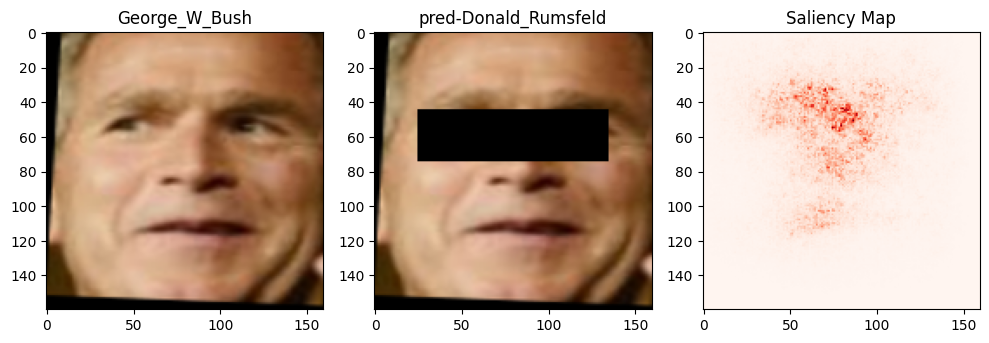

CLASS -  Gerhard_Schroeder
1/1 [==============================] - 0s 28ms/step
prediction -  [[0.04347831 0.16171296 0.22836506 0.04922502 0.51721865]]


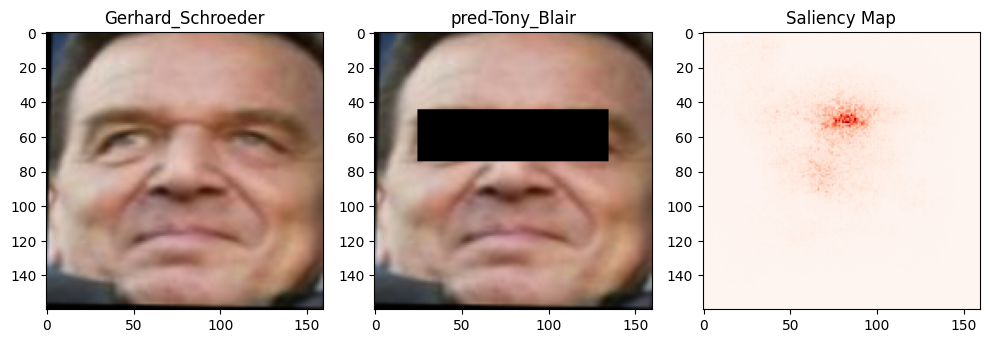

1/1 [==============================] - 0s 25ms/step
prediction -  [[3.6810488e-05 1.2610774e-04 1.0804948e-03 4.5338469e-03 9.9422270e-01]]


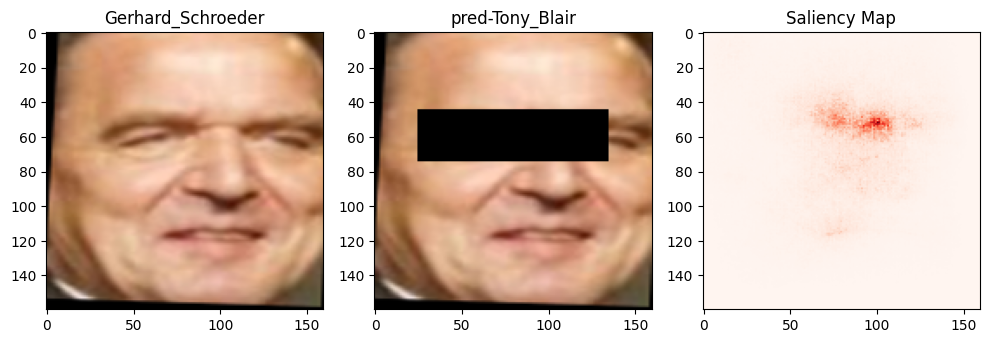

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.00278047 0.00782505 0.01499583 0.03861213 0.9357865 ]]


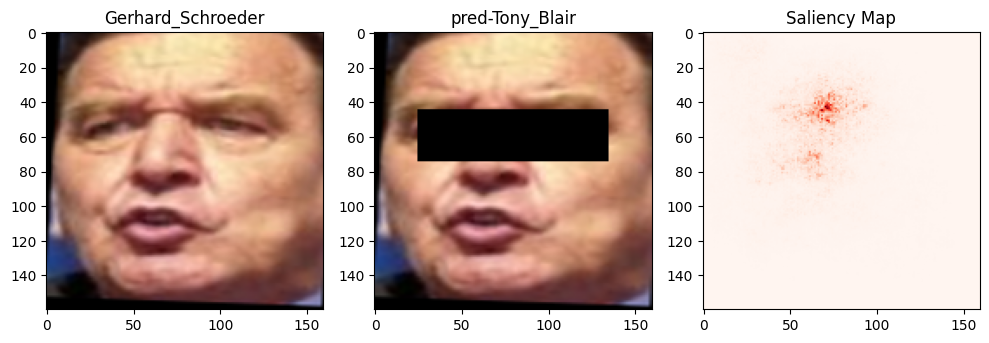

1/1 [==============================] - 0s 26ms/step
prediction -  [[3.1734638e-05 1.0945304e-04 7.6805241e-04 3.9530345e-03 9.9513775e-01]]


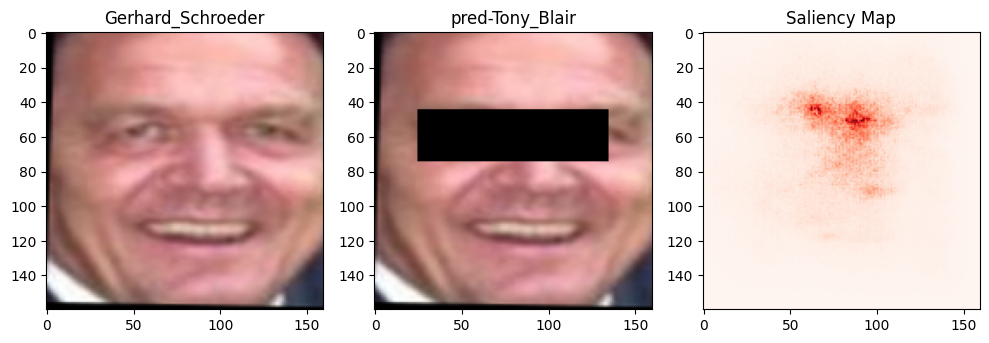

1/1 [==============================] - 0s 42ms/step
prediction -  [[5.3594467e-05 2.0252512e-04 1.4653092e-03 7.3280171e-03 9.9095047e-01]]


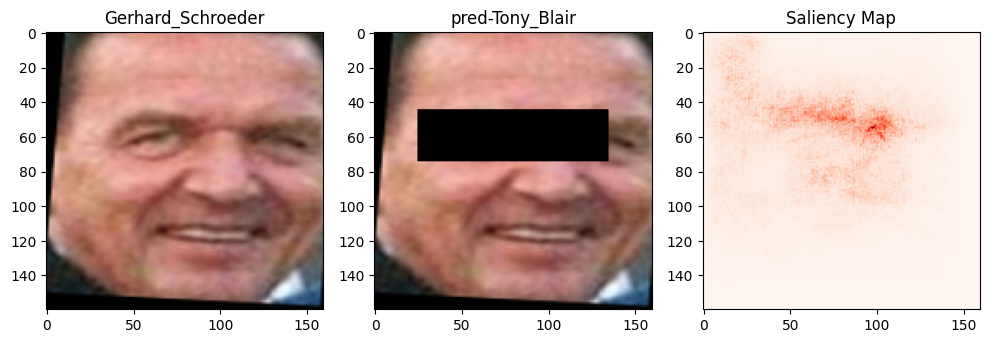

CLASS -  Tony_Blair
1/1 [==============================] - 0s 26ms/step
prediction -  [[8.7772903e-04 3.4180433e-03 1.0828471e-02 1.8844536e-02 9.6603119e-01]]


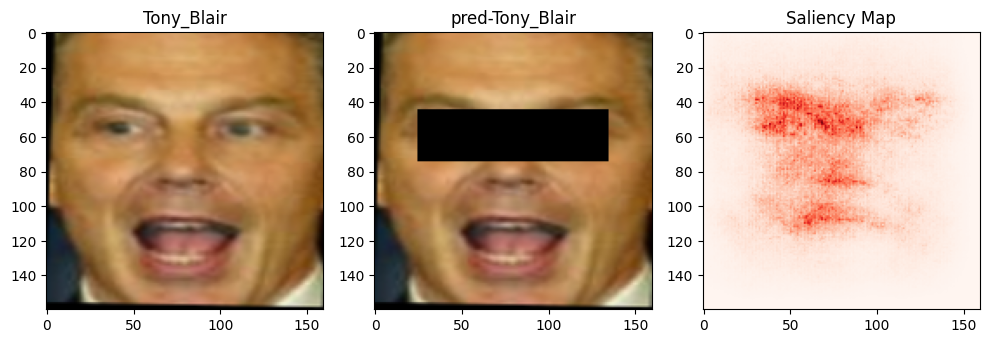

1/1 [==============================] - 0s 39ms/step
prediction -  [[0.00127955 0.00352791 0.0092418  0.01941163 0.9665391 ]]


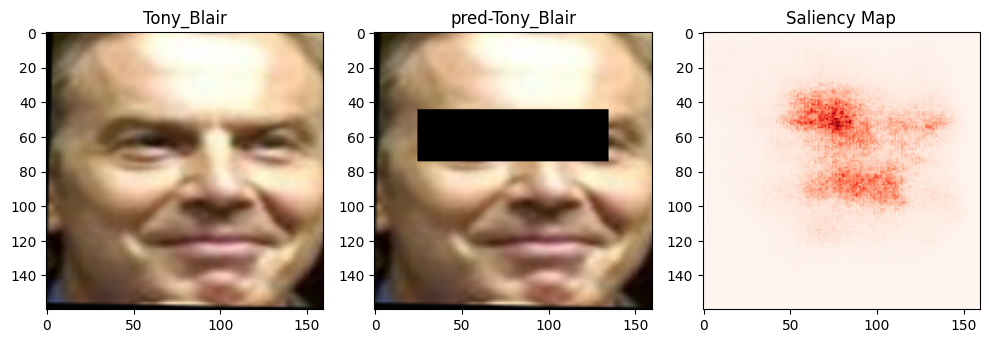

1/1 [==============================] - 0s 26ms/step
prediction -  [[0.15730399 0.791049   0.04732226 0.00106492 0.0032598 ]]


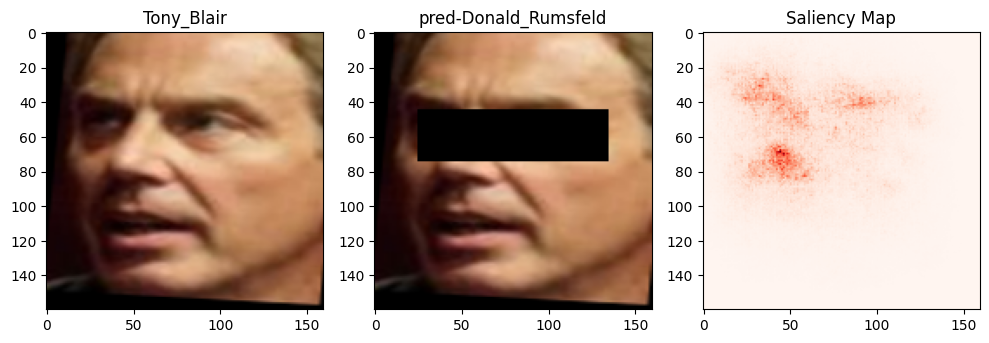

1/1 [==============================] - 0s 37ms/step
prediction -  [[0.03437235 0.20694466 0.17810084 0.07280479 0.50777733]]


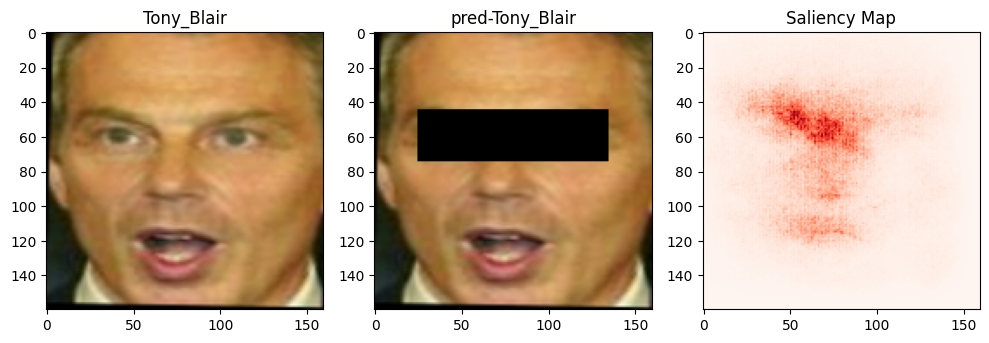

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.21241888 0.7396098  0.04305303 0.00112438 0.00379393]]


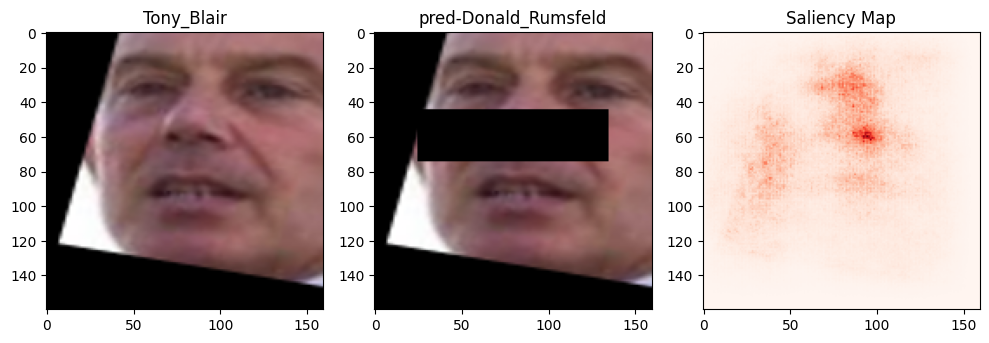

In [ ]:
## Both Eyes

unique_classes = np.unique(testy_encoded)

# Setting up a dictionary to store indices of each class
class_indices = {cls: np.where(testy_encoded == cls)[0] for cls in unique_classes}

subplot_args = {
   'nrows': 1,
   'ncols': 3,
   'figsize': (10, 5)
}

saliency = Saliency(model, clone=False)

for row, class_id in enumerate(unique_classes):
    print('CLASS - ', label_encoder.inverse_transform([class_id])[0])
    available_indices = class_indices[class_id]
    selected_indices = sample(list(available_indices), min(len(available_indices), 5))
    for col, idx in enumerate(selected_indices):

      score = CategoricalScore([class_id])

      f, ax = plt.subplots(**subplot_args)

      r_face = testX[idx]
      r_face_class = testy[idx]

      # Original image on the left
      ax[0].imshow(r_face.squeeze())
      ax[0].set_title(r_face_class)
      ax[0].axis('on')

      saliency_map = saliency(score, r_face, smooth_samples=20, smooth_noise=0.2)
      saliency_map = normalize(saliency_map)

      pred, im = occlude_image_and_predict_full(model, r_face)

      # Saliency map on the right
      ax[1].imshow(im)
      ax[1].set_title(f'pred-{pred[0]}')
      ax[1].axis('on')  # 'on' to turn on axis

      # Saliency map on the right
      ax[2].imshow(saliency_map[0], cmap='Reds')
      ax[2].set_title('Saliency Map')
      ax[2].axis('on')

      plt.tight_layout()
      plt.show()

      del r_face
      del im

CLASS -  Colin_Powell
1/1 [==============================] - 0s 27ms/step
prediction -  [[0.9614608  0.0239682  0.00446333 0.00247121 0.00763648]]


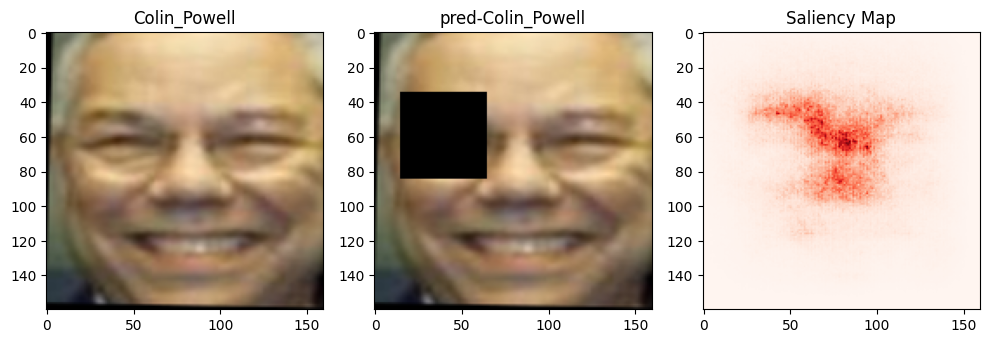

1/1 [==============================] - 0s 26ms/step
prediction -  [[1.0000000e+00 2.2267487e-08 1.6082490e-10 1.1512281e-11 8.4567184e-13]]


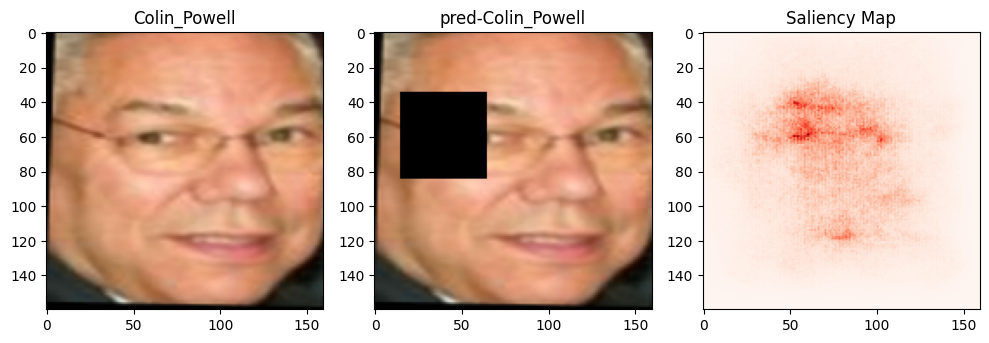

1/1 [==============================] - 0s 25ms/step
prediction -  [[0.1402219  0.8198148  0.03497081 0.00129802 0.00369447]]


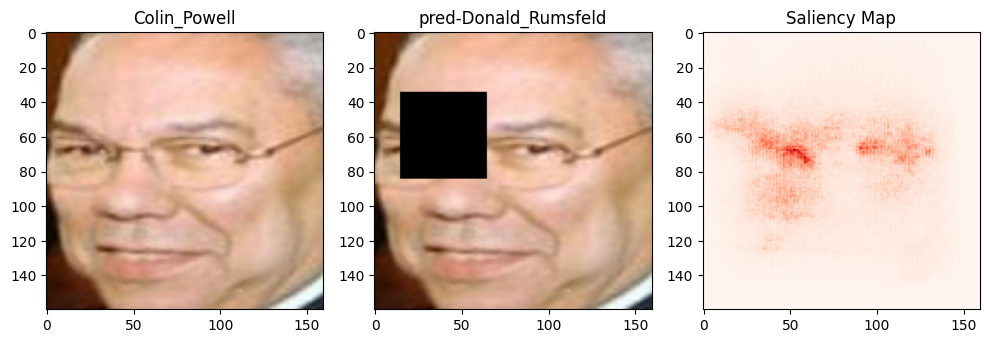

1/1 [==============================] - 0s 42ms/step
prediction -  [[4.9481433e-02 9.4952404e-01 3.6629988e-04 4.1878180e-04 2.0935308e-04]]


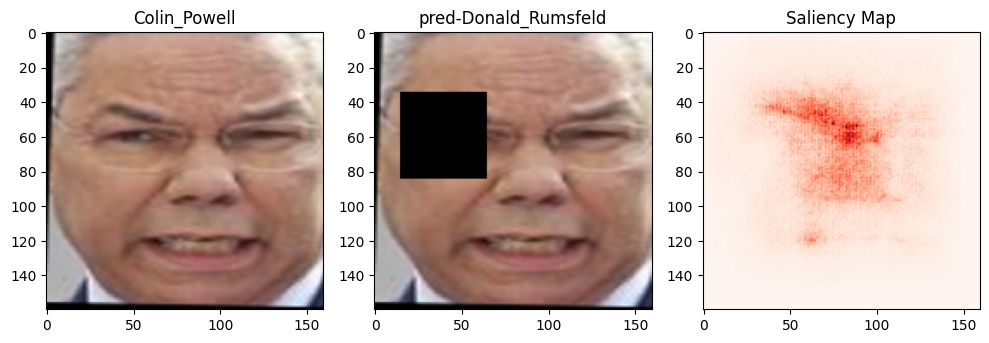

1/1 [==============================] - 0s 27ms/step
prediction -  [[0.7328845  0.2342386  0.01993866 0.00523244 0.00770574]]


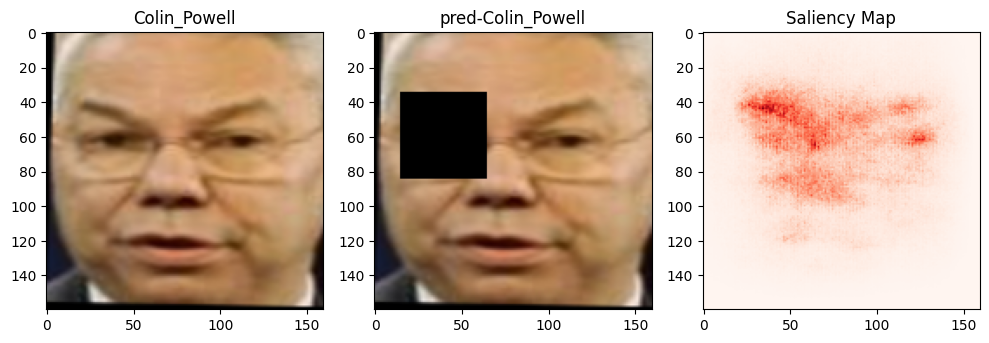

CLASS -  Donald_Rumsfeld
1/1 [==============================] - 0s 40ms/step
prediction -  [[3.5004321e-04 9.9939585e-01 2.2049311e-04 8.4324611e-06 2.5080650e-05]]


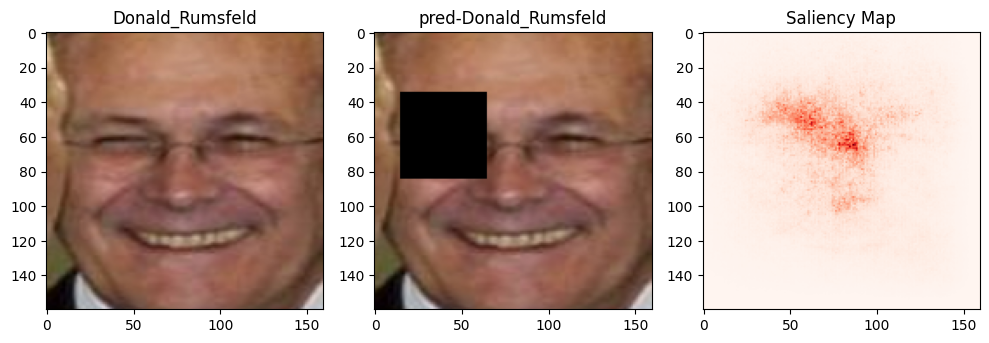

1/1 [==============================] - 0s 25ms/step
prediction -  [[5.0704984e-04 9.9847668e-01 9.5876836e-04 1.0479578e-05 4.7048430e-05]]


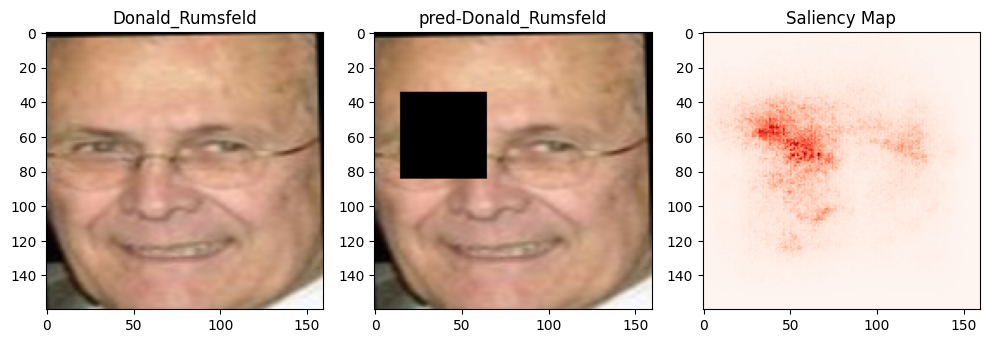

1/1 [==============================] - 0s 24ms/step
prediction -  [[7.086025e-18 1.000000e+00 8.013760e-18 1.817196e-21 1.425046e-19]]


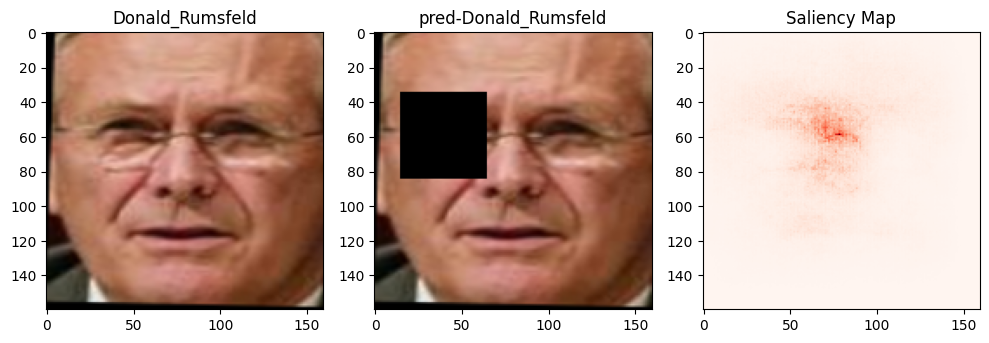

1/1 [==============================] - 0s 26ms/step
prediction -  [[5.5376273e-07 9.9999893e-01 5.2569891e-07 7.8055455e-09 4.5184706e-08]]


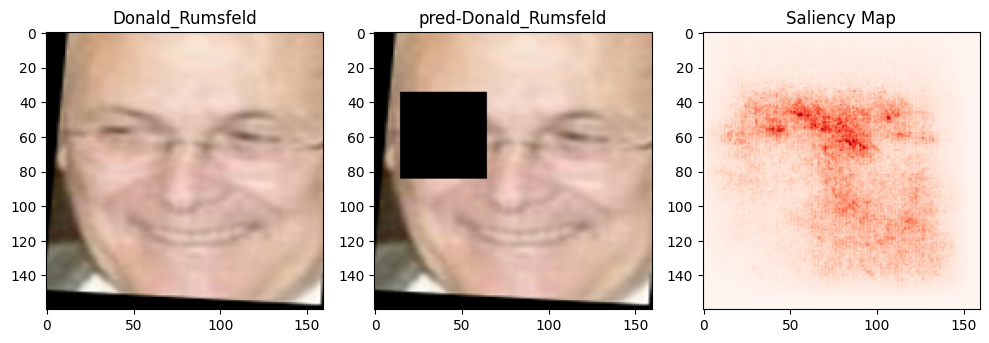

1/1 [==============================] - 0s 49ms/step
prediction -  [[1.8926774e-05 9.9997735e-01 3.0686033e-06 1.8754767e-07 5.1260878e-07]]


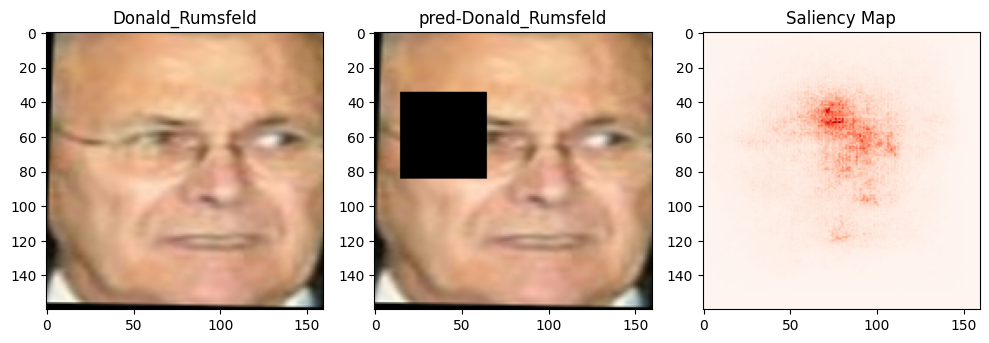

CLASS -  George_W_Bush
1/1 [==============================] - 0s 29ms/step
prediction -  [[5.4090803e-09 1.1820738e-08 1.0000000e+00 7.6431937e-11 2.4579025e-09]]


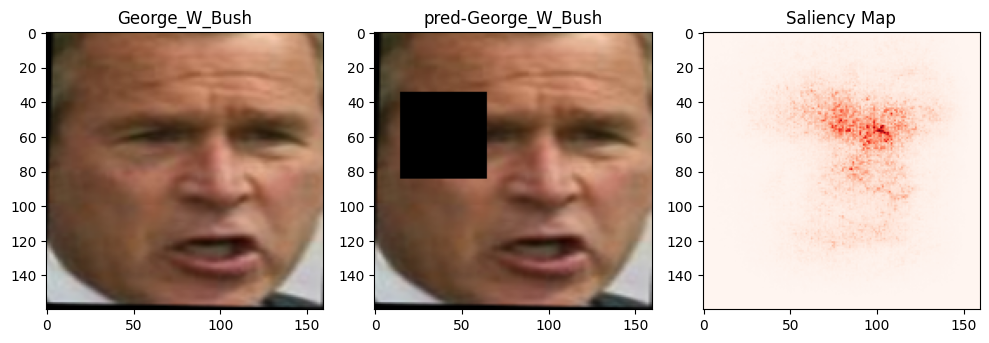

1/1 [==============================] - 0s 25ms/step
prediction -  [[1.4327420e-06 4.3510886e-06 9.9999309e-01 6.6514374e-08 9.9328361e-07]]


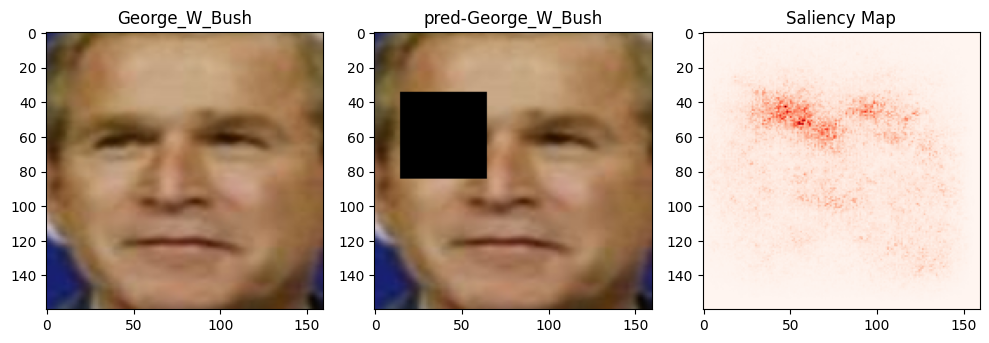

1/1 [==============================] - 0s 26ms/step
prediction -  [[1.63878511e-07 4.65195768e-07 9.99999285e-01 5.82230575e-09
  1.14590605e-07]]


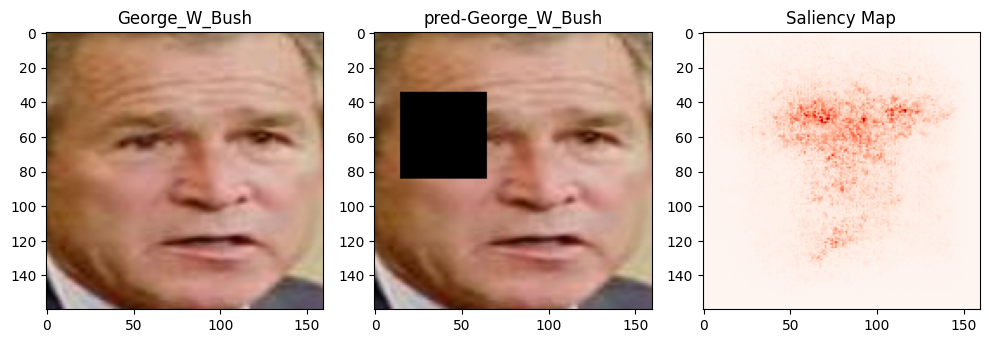

1/1 [==============================] - 0s 28ms/step
prediction -  [[8.2307501e-08 2.3236240e-07 9.9999964e-01 2.1703406e-09 4.6470092e-08]]


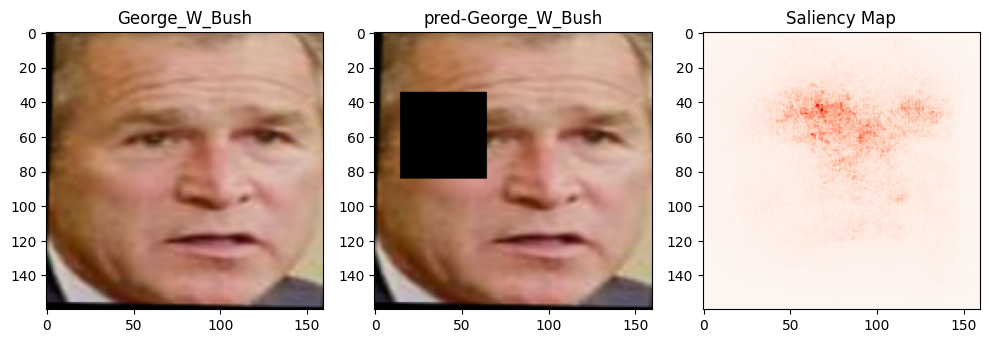

1/1 [==============================] - 0s 44ms/step
prediction -  [[8.0581327e-14 6.9494073e-14 1.0000000e+00 1.1756743e-16 1.8609988e-14]]


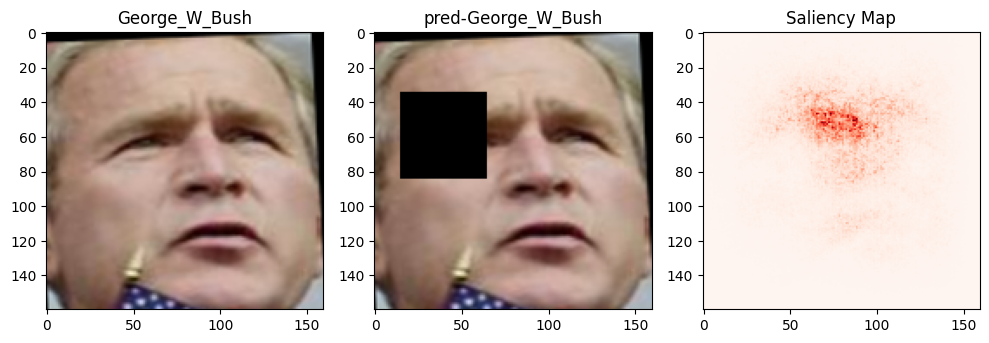

CLASS -  Gerhard_Schroeder
1/1 [==============================] - 0s 26ms/step
prediction -  [[1.6304265e-03 3.9679976e-04 8.6888188e-04 9.9504673e-01 2.0571835e-03]]


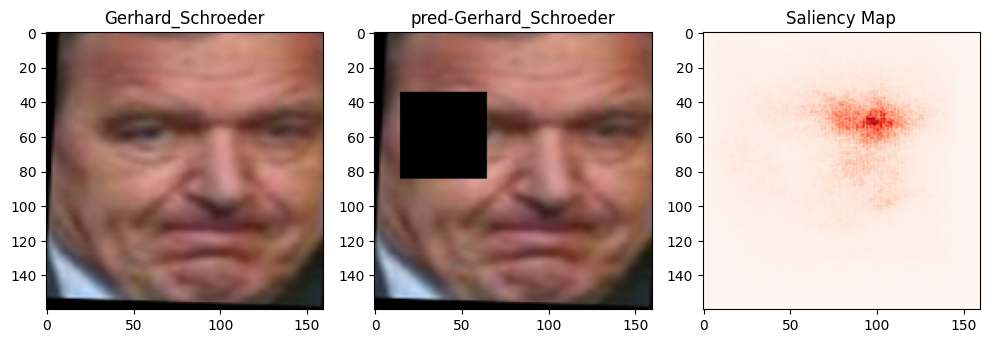

1/1 [==============================] - 0s 39ms/step
prediction -  [[0.01959075 0.00463396 0.00653414 0.00257404 0.9666672 ]]


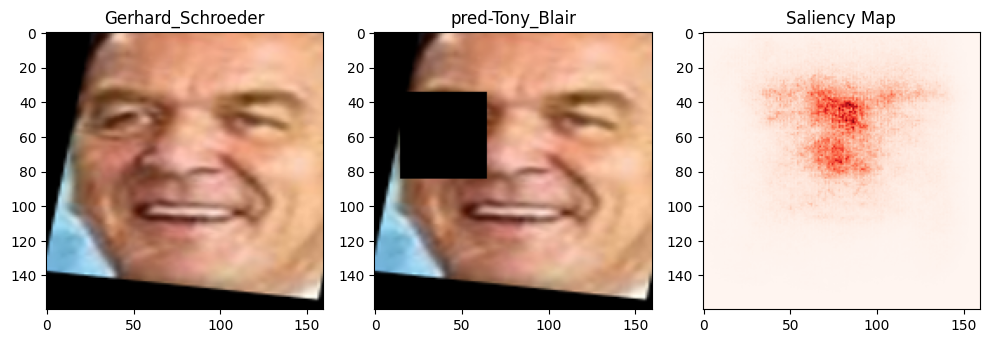

1/1 [==============================] - 0s 28ms/step
prediction -  [[1.8572988e-04 2.4190993e-05 6.0881204e-05 9.9949062e-01 2.3850506e-04]]


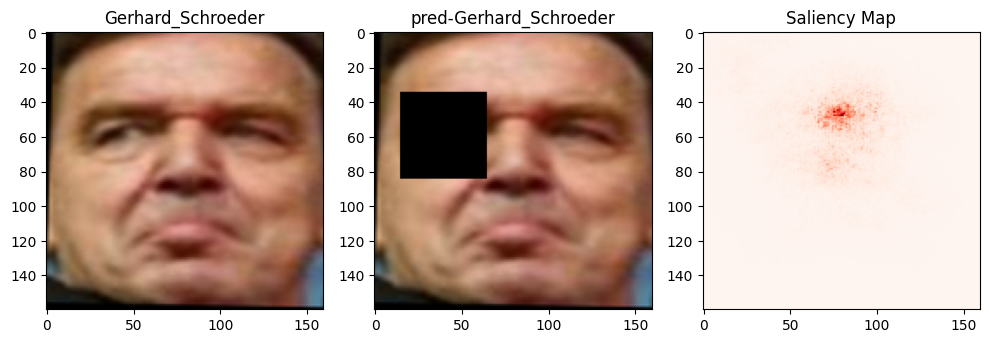

1/1 [==============================] - 0s 38ms/step
prediction -  [[2.8362984e-04 9.1021117e-05 1.4030015e-04 9.9888724e-01 5.9788110e-04]]


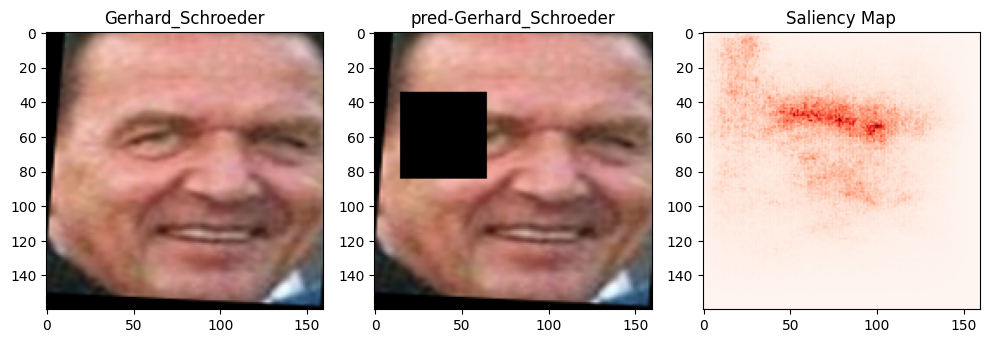

1/1 [==============================] - 0s 26ms/step
prediction -  [[0.01866423 0.06165748 0.00551598 0.89832836 0.01583395]]


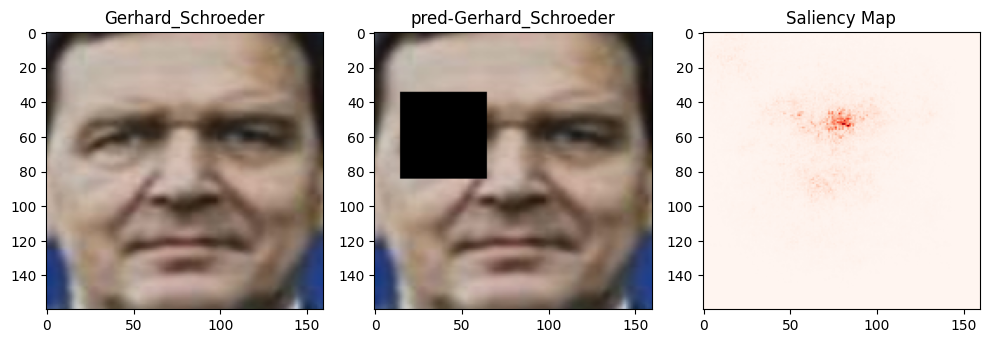

CLASS -  Tony_Blair
1/1 [==============================] - 0s 28ms/step
prediction -  [[0.09903851 0.14939974 0.21662512 0.01598879 0.51894784]]


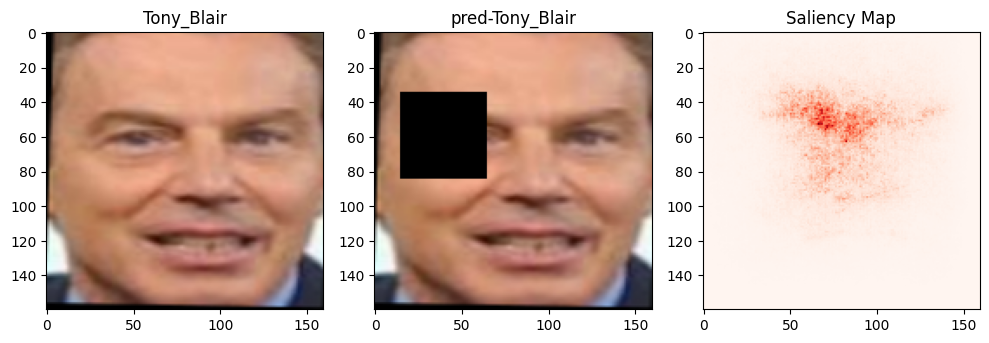

1/1 [==============================] - 0s 25ms/step
prediction -  [[0.30341983 0.6327624  0.05343277 0.00271322 0.00767179]]


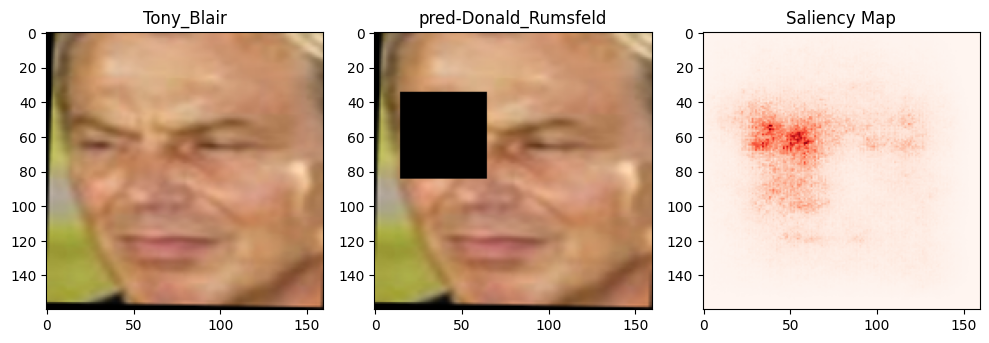

1/1 [==============================] - 0s 25ms/step
prediction -  [[0.2687558  0.65488803 0.06149987 0.0037031  0.01115325]]


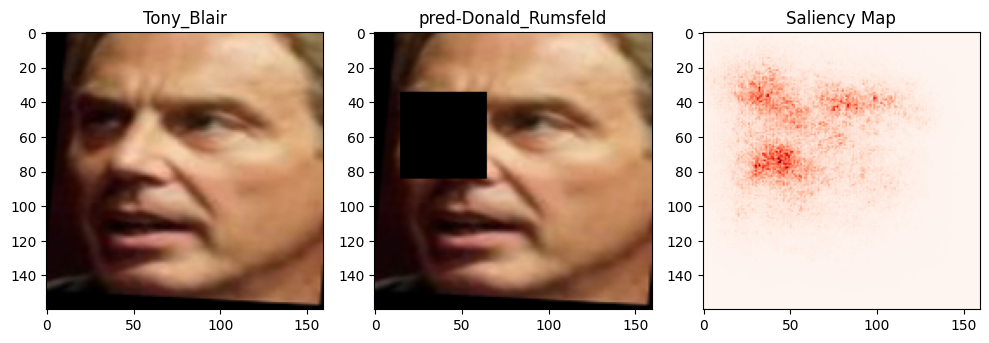

1/1 [==============================] - 0s 26ms/step
prediction -  [[0.40885106 0.38858303 0.08573931 0.01554433 0.1012823 ]]


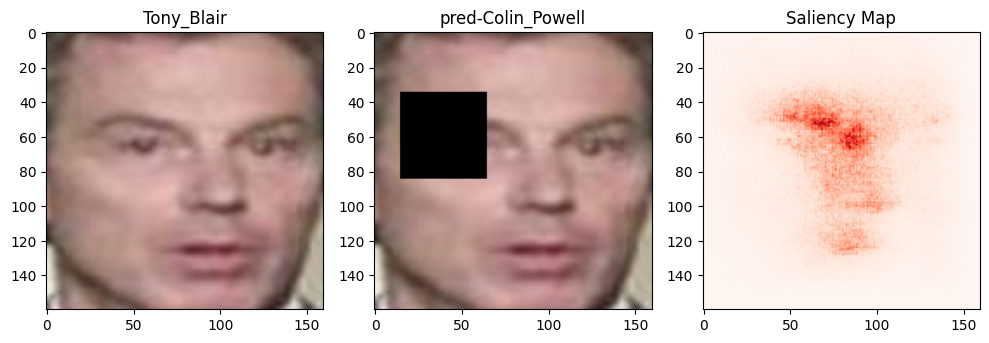

1/1 [==============================] - 0s 33ms/step
prediction -  [[0.08010038 0.08749399 0.1462276  0.01214657 0.6740315 ]]


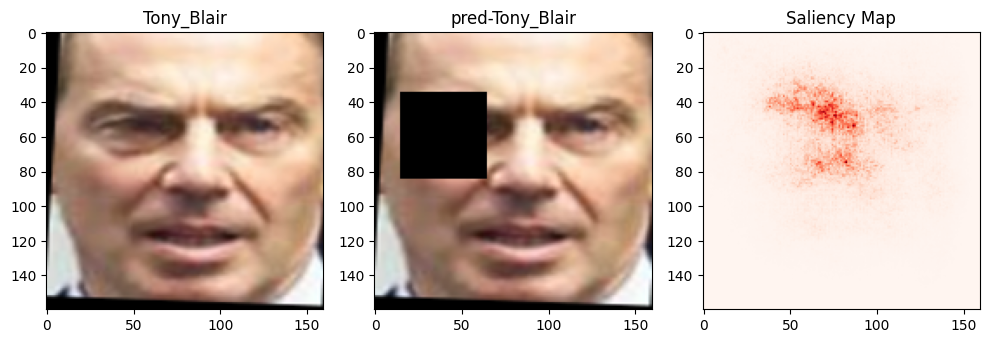

In [ ]:
## Right eye

unique_classes = np.unique(testy_encoded)

# Setting up a dictionary to store indices of each class
class_indices = {cls: np.where(testy_encoded == cls)[0] for cls in unique_classes}
subplot_args = {
   'nrows': 1,
   'ncols': 3,
   'figsize': (10, 5)
}

saliency = Saliency(model, clone=False)

for row, class_id in enumerate(unique_classes):
    print('CLASS - ', label_encoder.inverse_transform([class_id])[0])
    available_indices = class_indices[class_id]
    selected_indices = sample(list(available_indices), min(len(available_indices), 5))
    for col, idx in enumerate(selected_indices):

      score = CategoricalScore([class_id])

      f, ax = plt.subplots(**subplot_args)

      r_face = testX[idx]
      r_face_class = testy[idx]

      # Original image on the left
      ax[0].imshow(r_face.squeeze())
      ax[0].set_title(r_face_class)
      ax[0].axis('on')

      saliency_map = saliency(score, r_face, smooth_samples=20, smooth_noise=0.2)
      saliency_map = normalize(saliency_map)

      pred, im = occlude_image_and_predict_right(model, r_face)

      # Saliency map on the right
      ax[1].imshow(im)
      ax[1].set_title(f'pred-{pred[0]}')
      ax[1].axis('on')

      # Saliency map on the right
      ax[2].imshow(saliency_map[0], cmap='Reds')
      ax[2].set_title('Saliency Map')
      ax[2].axis('on')

      plt.tight_layout()
      plt.show()

      del r_face
      del im

CLASS -  Colin_Powell
1/1 [==============================] - 0s 40ms/step
prediction -  [[0.21248703 0.49466446 0.21971455 0.01102404 0.06210996]]


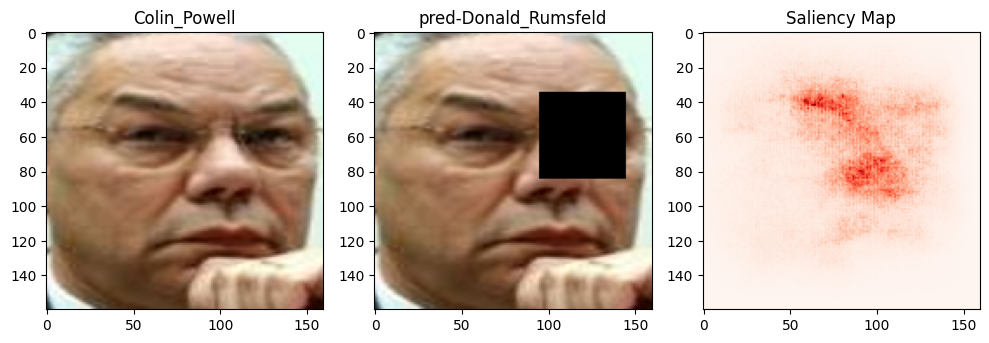

1/1 [==============================] - 0s 31ms/step
prediction -  [[1.0000000e+00 4.0281159e-12 3.7492478e-13 1.6120223e-15 2.9011421e-17]]


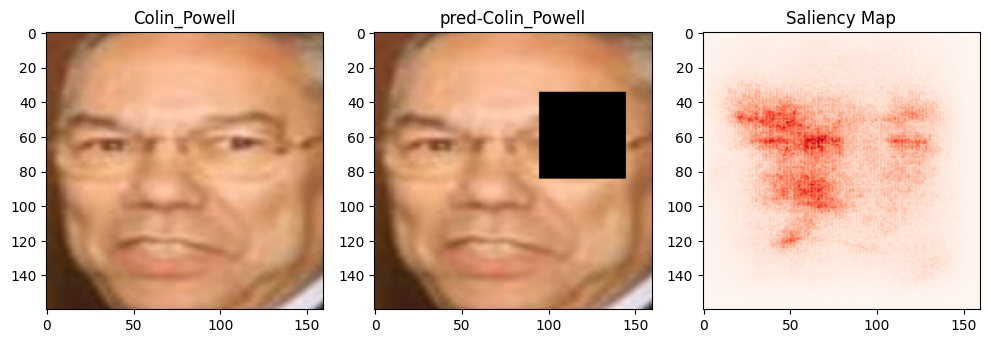

1/1 [==============================] - 0s 40ms/step
prediction -  [[1.0000000e+00 2.8067018e-13 3.3754815e-14 3.2752577e-17 2.2854496e-19]]


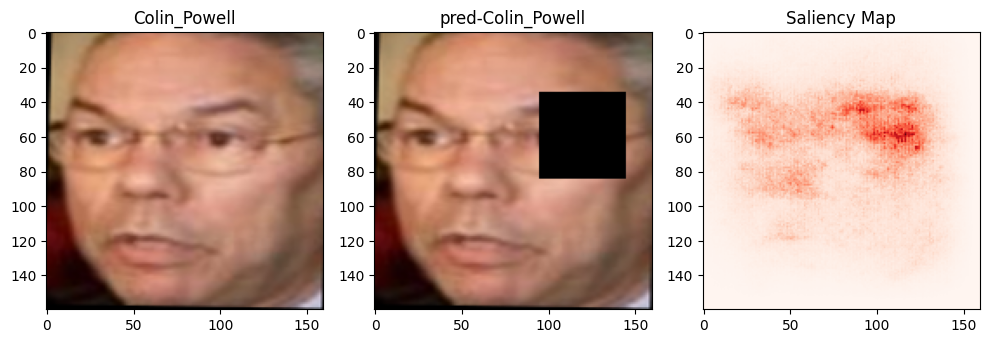

1/1 [==============================] - 0s 26ms/step
prediction -  [[1.0000000e+00 1.2998151e-08 2.7811449e-09 5.3779248e-11 4.2109189e-12]]


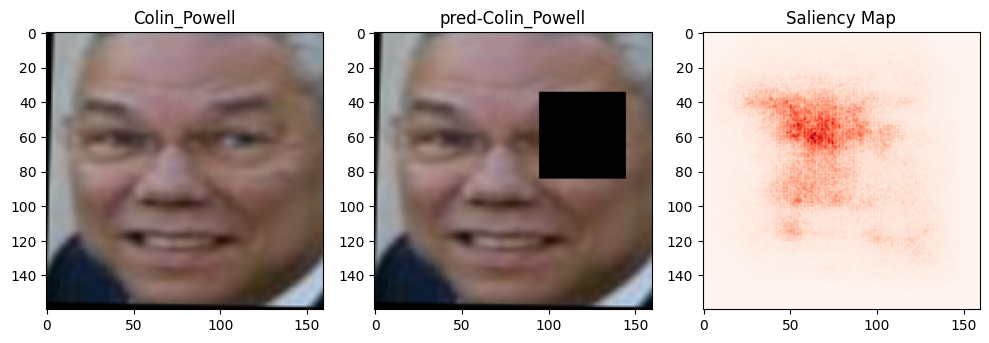

1/1 [==============================] - 0s 33ms/step
prediction -  [[9.9902749e-01 6.4990320e-04 2.1037643e-04 5.3946809e-05 5.8339367e-05]]


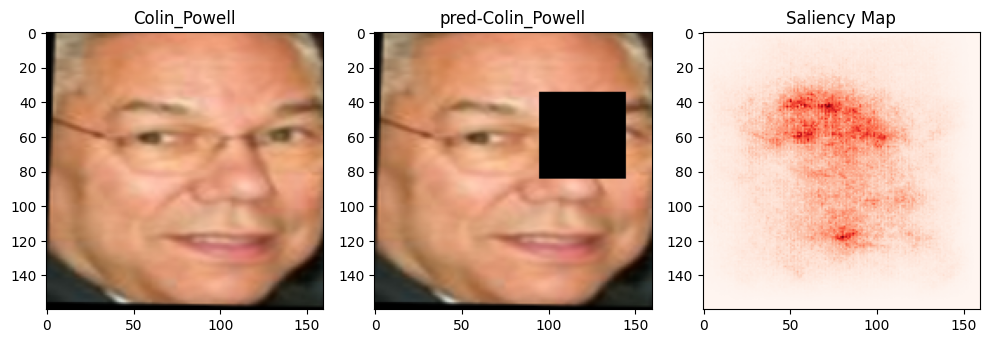

CLASS -  Donald_Rumsfeld
1/1 [==============================] - 0s 26ms/step
prediction -  [[3.3075612e-05 9.9864179e-01 1.2982801e-03 3.8401454e-06 2.2977763e-05]]


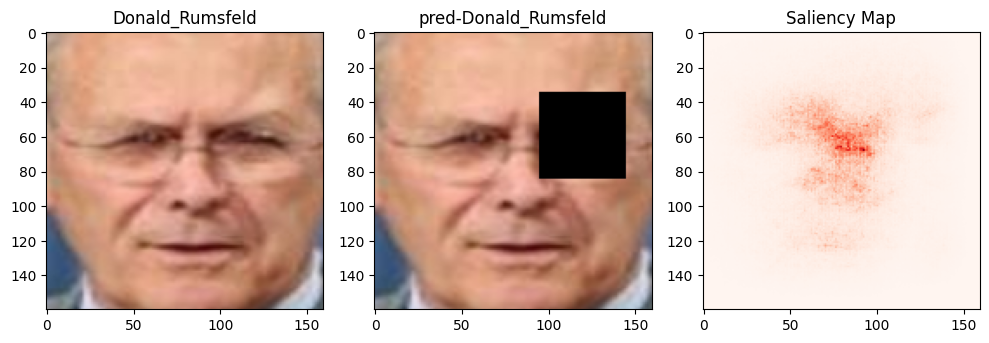

1/1 [==============================] - 0s 26ms/step
prediction -  [[8.2125296e-12 1.0000000e+00 5.3228793e-11 4.6810852e-14 1.1691291e-12]]


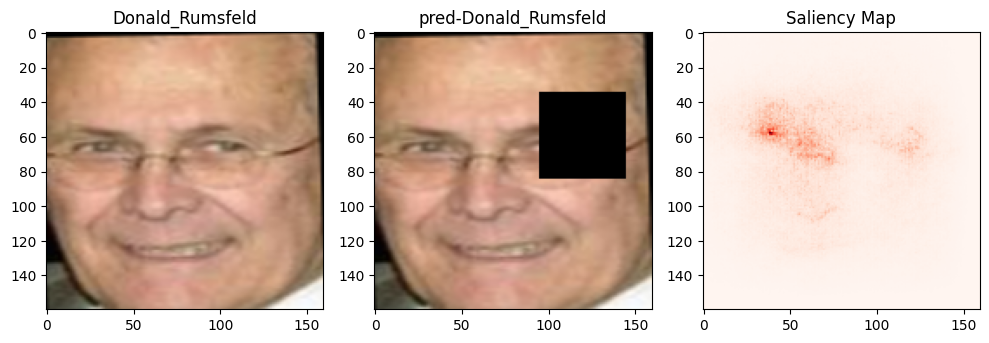

1/1 [==============================] - 0s 45ms/step
prediction -  [[2.7839016e-04 9.9849749e-01 5.3378858e-04 2.4295867e-04 4.4732948e-04]]


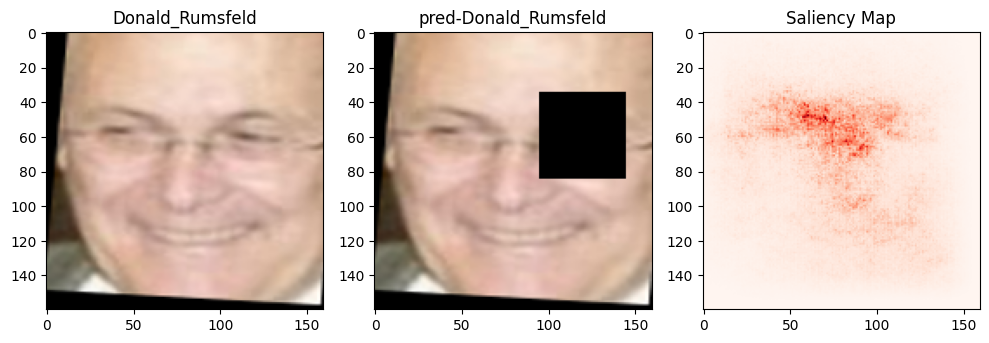

1/1 [==============================] - 0s 28ms/step
prediction -  [[2.3918274e-05 9.9995935e-01 1.4600561e-05 3.8083570e-07 1.6523829e-06]]


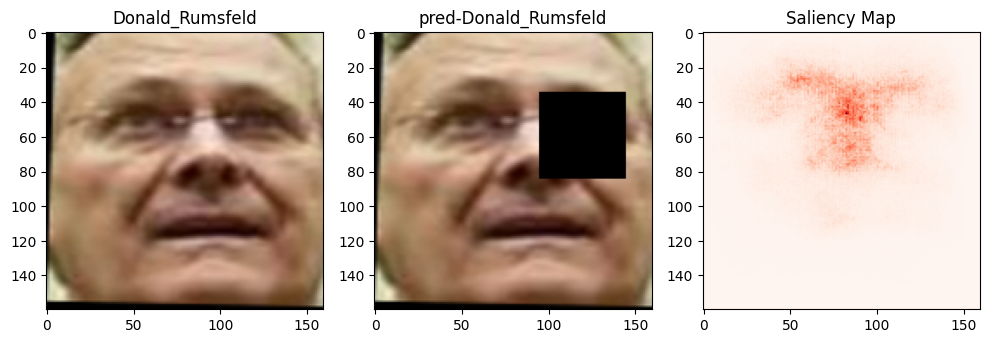

1/1 [==============================] - 0s 27ms/step
prediction -  [[1.0042004e-09 1.0000000e+00 2.9628802e-09 9.5730403e-12 1.1285872e-10]]


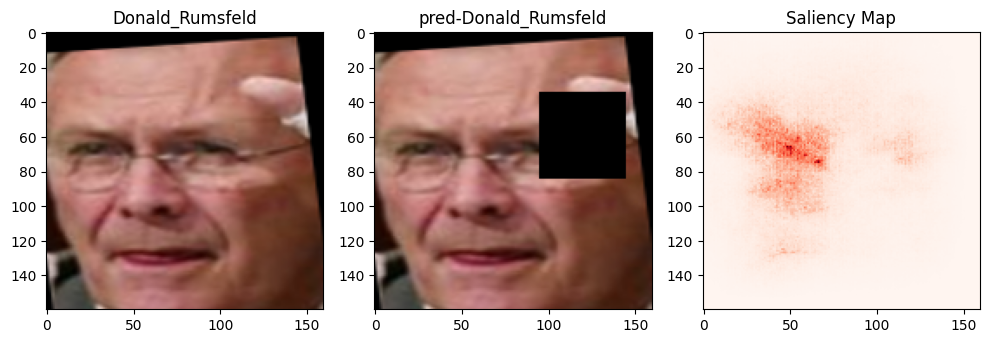

CLASS -  George_W_Bush
1/1 [==============================] - 0s 27ms/step
prediction -  [[5.3362087e-10 8.0926510e-10 1.0000000e+00 8.8583784e-12 4.2300577e-10]]


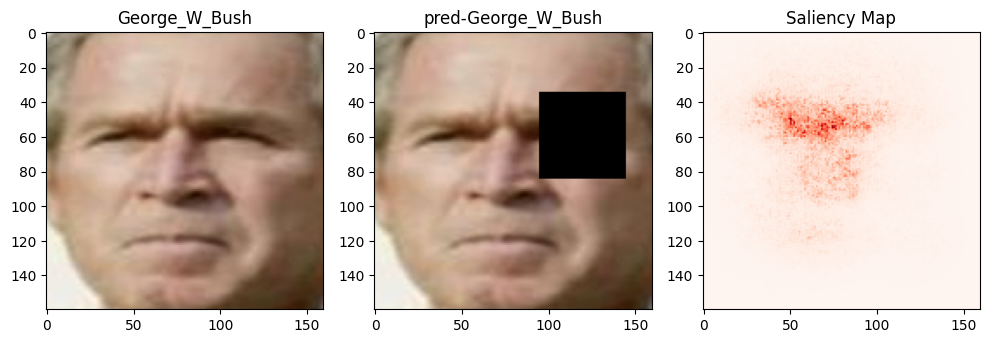

1/1 [==============================] - 0s 44ms/step
prediction -  [[0.00108647 0.00366315 0.94225323 0.00254984 0.0504474 ]]


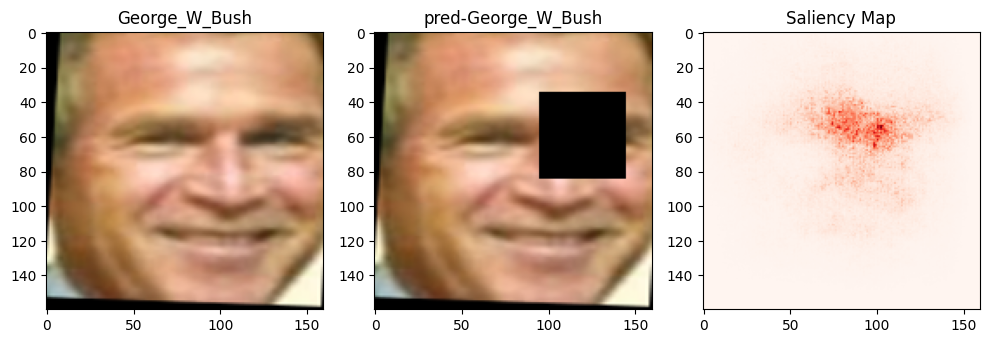

1/1 [==============================] - 0s 27ms/step
prediction -  [[9.3896483e-13 1.0457823e-12 1.0000000e+00 4.0525461e-15 4.8344743e-13]]


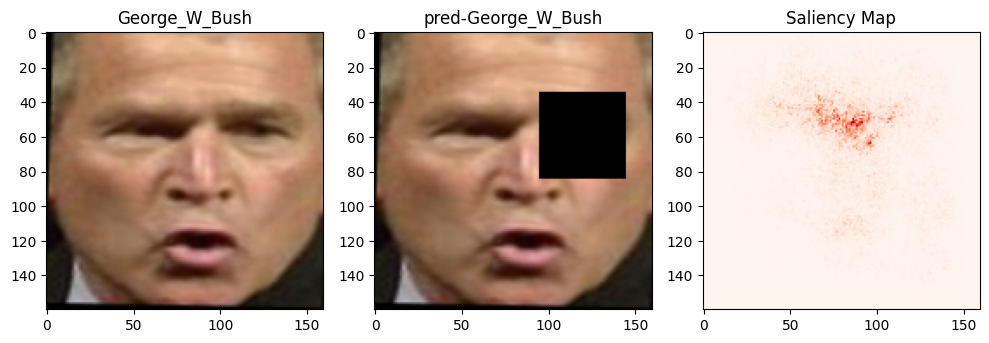

1/1 [==============================] - 0s 42ms/step
prediction -  [[5.7455299e-08 7.7980111e-08 9.9999976e-01 2.3700750e-09 6.1794388e-08]]


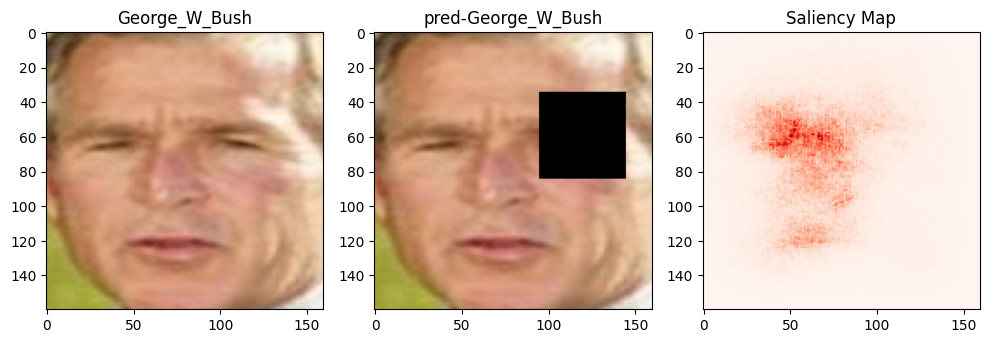

1/1 [==============================] - 0s 27ms/step
prediction -  [[4.1562369e-15 3.4350638e-15 1.0000000e+00 9.0333078e-18 2.1652612e-15]]


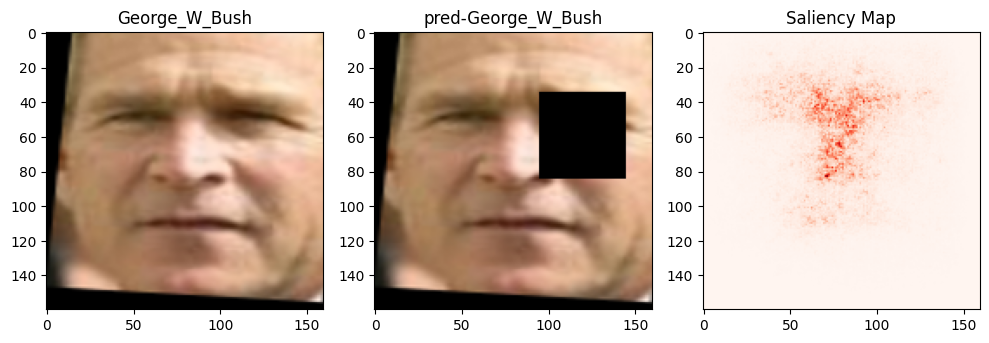

CLASS -  Gerhard_Schroeder
1/1 [==============================] - 0s 44ms/step
prediction -  [[1.5742391e-07 1.1628343e-07 2.3899629e-06 9.9566287e-01 4.3345187e-03]]


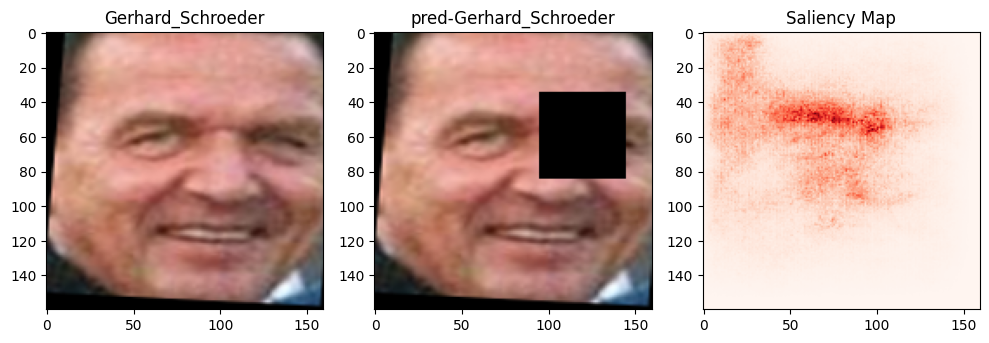

1/1 [==============================] - 0s 31ms/step
prediction -  [[1.2892185e-07 4.8987989e-08 6.0829035e-07 9.9983883e-01 1.6044409e-04]]


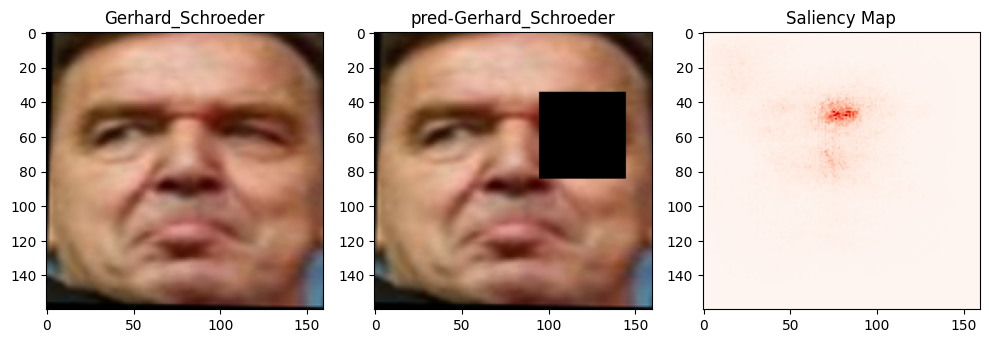

1/1 [==============================] - 0s 39ms/step
prediction -  [[3.7468384e-09 1.4516215e-10 3.3418830e-09 9.9999988e-01 1.4651397e-07]]


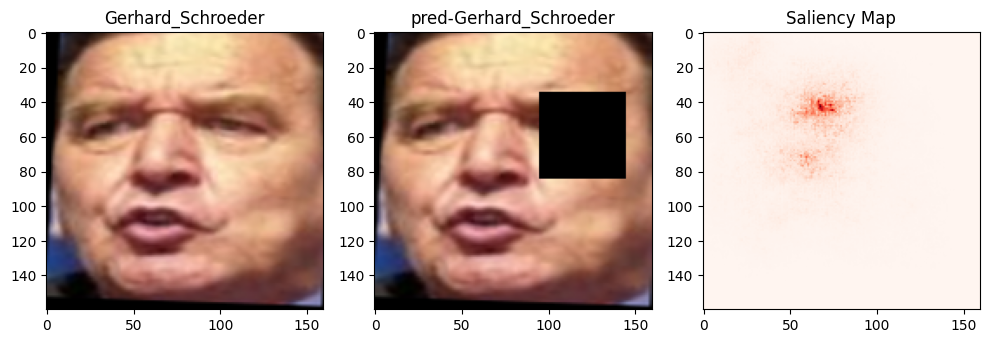

1/1 [==============================] - 0s 27ms/step
prediction -  [[2.38381244e-06 2.26431689e-06 3.95293682e-05 8.78022611e-01
  1.21933244e-01]]


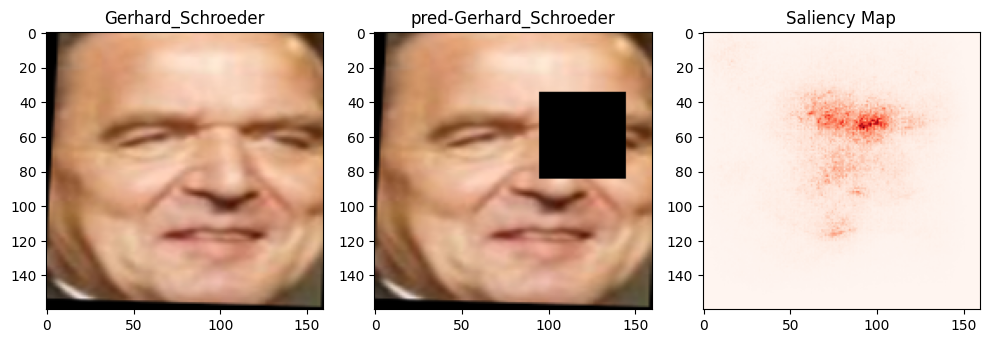

1/1 [==============================] - 0s 29ms/step
prediction -  [[8.0138375e-07 1.1303911e-06 3.8629631e-05 2.1637985e-02 9.7832149e-01]]


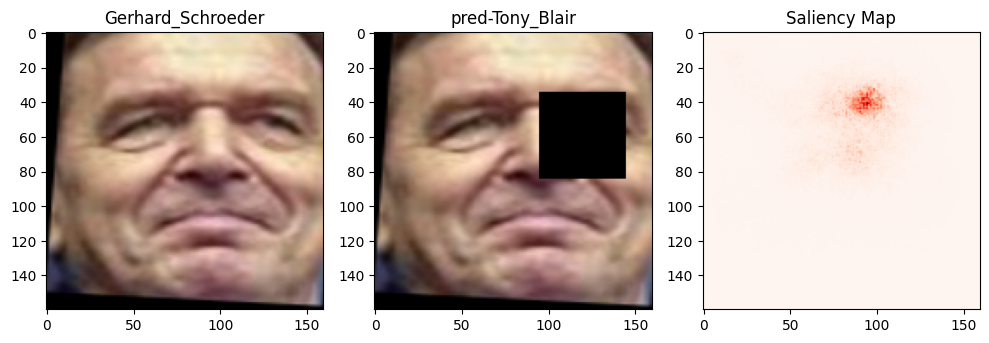

CLASS -  Tony_Blair
1/1 [==============================] - 0s 43ms/step
prediction -  [[9.4347524e-05 2.2375332e-05 7.3989133e-05 4.7192007e-05 9.9976212e-01]]


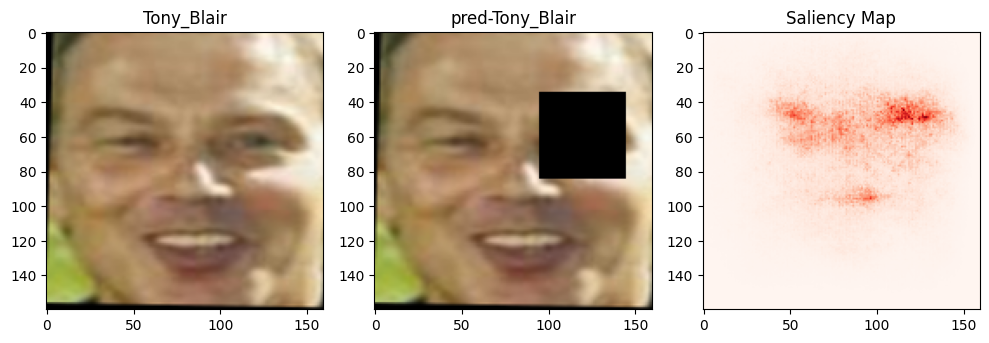

1/1 [==============================] - 0s 28ms/step
prediction -  [[0.02845455 0.14331214 0.78920704 0.0043912  0.03463504]]


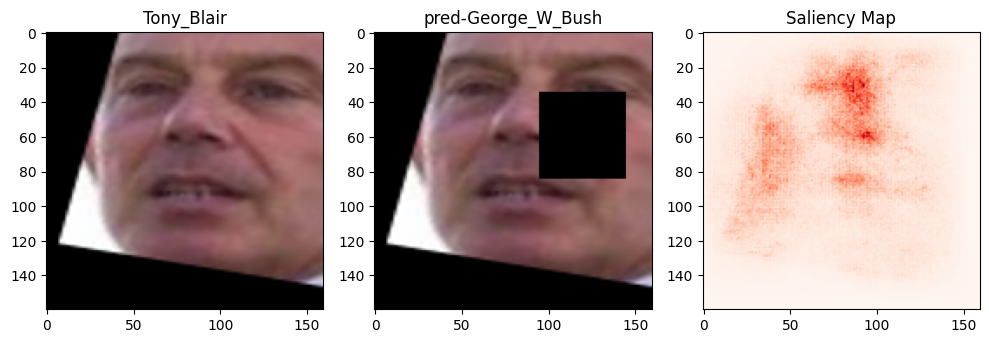

1/1 [==============================] - 0s 29ms/step
prediction -  [[2.1824434e-04 7.5591117e-04 9.1786522e-01 1.6628468e-03 7.9497762e-02]]


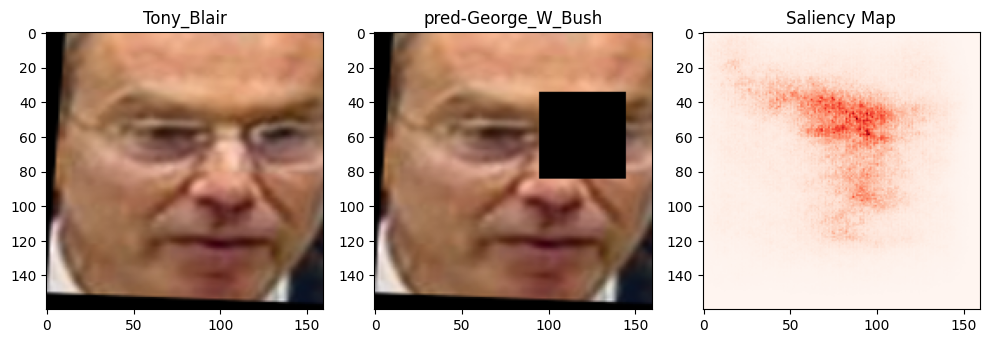

1/1 [==============================] - 0s 46ms/step
prediction -  [[5.6632573e-05 7.8686251e-05 1.5442654e-03 1.1463711e-03 9.9717402e-01]]


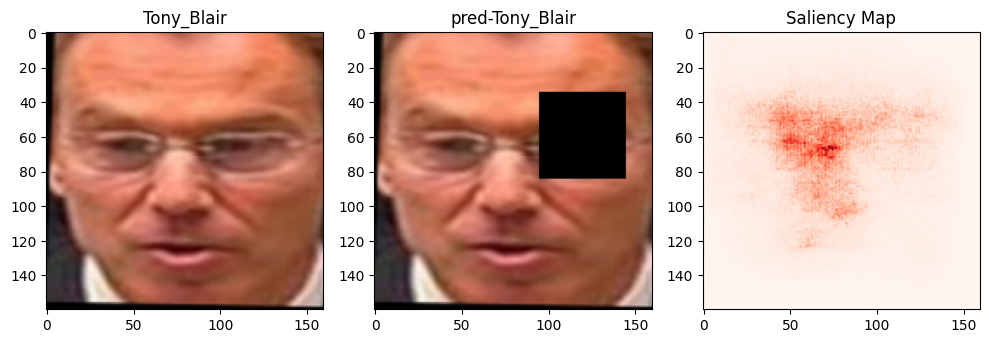

1/1 [==============================] - 0s 29ms/step
prediction -  [[0.00259054 0.00454133 0.01127292 0.00704784 0.97454745]]


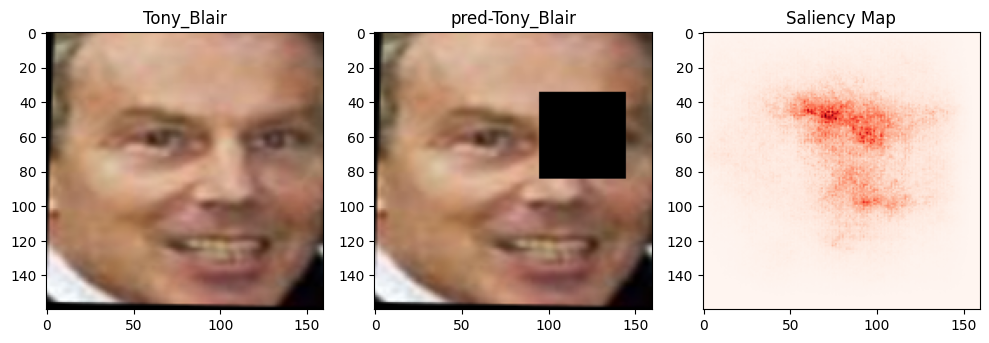

In [ ]:
# Left Eye

unique_classes = np.unique(testy_encoded)

# Setting up a dictionary to store indices of each class
class_indices = {cls: np.where(testy_encoded == cls)[0] for cls in unique_classes}
subplot_args = {
   'nrows': 1,
   'ncols': 3,
   'figsize': (10, 5)
}

saliency = Saliency(model, clone=False)

for row, class_id in enumerate(unique_classes):
    print('CLASS - ', label_encoder.inverse_transform([class_id])[0])
    available_indices = class_indices[class_id]
    selected_indices = sample(list(available_indices), min(len(available_indices), 5))
    for col, idx in enumerate(selected_indices):

      score = CategoricalScore([class_id])

      f, ax = plt.subplots(**subplot_args)

      r_face = testX[idx]
      r_face_class = testy[idx]

      # Original image on the left
      ax[0].imshow(r_face.squeeze())
      ax[0].set_title(r_face_class)
      ax[0].axis('on')

      saliency_map = saliency(score, r_face, smooth_samples=20, smooth_noise=0.2)
      saliency_map = normalize(saliency_map)

      pred, im = occlude_image_and_predict_left(model, r_face)

      # Saliency map on the right
      ax[1].imshow(im)
      ax[1].set_title(f'pred-{pred[0]}')
      ax[1].axis('on')

      # Saliency map on the right
      ax[2].imshow(saliency_map[0], cmap='Reds')
      ax[2].set_title('Saliency Map')
      ax[2].axis('on')

      plt.tight_layout()
      plt.show()

      del r_face
      del im